# Importar librerias

In [17]:
#!pip install torch
#!pip install piqa
#!pip install dists-pytorch

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import tensorflow as tf
from skimage import img_as_float
#from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error
import torch
#https://networkcult.com/fix-userwarning-the-parameter-pretrained-is-deprecated-since-0-13-and-will-be-removed-in-0-15-please-use-weights-instead-4180/
import torchvision.models.detection as detection  
#weights= detection.MaskRCNN_ResNet50_FPN_Weights.DEFAULT
#model = detection.maskrcnn_resnet50_fpn(weights=weights)
from piqa import SSIM
from piqa import PSNR
from DISTS_pytorch import DISTS

# Montar carpeta de imágenes en Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/rodiucan/datosimg
directorio_salida='/content/drive/MyDrive/rodiucan/salida/'

# Montar carpeta de imágenes en disco local

In [3]:
#ir a la carpeta de datos
%cd d:/rodiucan/datosimg
#Lugar donde se guardan los modelos
directorio_salida='d:/rodiucan/salida/'

d:\rodiucan\datosimg


# Funciones

In [4]:
#-----------------------FUNCION PARA OBTENER EL NOMBRE DE ARCHIVO SEGUN SU NUMERO
#Esta funcion debe cambiarse en caso de usar otro dataset de imagenes
def getNombreArchivo(num):
    #rellenar con ceros a la izquierda
    cad=str(num).rjust(3,'0')
    return 'im_'+cad
#-----------------------------------------------------------------------------------------------------------


In [5]:
#------------------------------FUNCIONES PARA MOSTRAR IMAGENES DE 2 3 Y 4 FILAS------------------
def mostrar_imagen_2f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}
        
        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)
        
        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_3f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}
        
        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)
        
        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)
        
        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_4f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3,xcarpeta4,xnom_img4):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

        ximg4=cv2.imread(xcarpeta4+'/'+getNombreArchivo(i)+xnom_img4+'.png')
        ximg4=cv2.cvtColor(ximg4, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,4)
        plt.title(getNombreArchivo(i)+xnom_img4+'.png')
        plt.imshow(ximg4,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_2f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2)

def mostrar_imagen_3f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}
        
        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        plt.imshow(ximg1)
        
        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2)
        
        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3)

def mostrar_imagen_4f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3,xcarpeta4,xnom_img4):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3)

        ximg4=cv2.imread(xcarpeta4+'/'+getNombreArchivo(i)+xnom_img4+'.png')
        ximg4=cv2.cvtColor(ximg4, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,4)
        plt.title(getNombreArchivo(i)+xnom_img4+'.png')
        plt.imshow(ximg4)
#--------------------------------------------------------------------------------------------

In [6]:
#------------------------------FUNCIONES PARA PRUEBAS DE SIMILITUD CON 4 METRICAS---------
def prueba_similitud(xposini,xposfin,filagraficar,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    y1mse=list()
    y2mse=list()
    y1ssim=list()
    y2ssim=list()
    y1psnr=list()
    y2psnr=list()
    y1dists=list()
    y2dists=list()

    for i in range(xposini,xposfin):
        #print(i)
        ximg=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg=cv2.cvtColor(ximg, cv2.COLOR_BGR2GRAY)
        data_ximg=img_as_float(ximg)#Escalar entre 0 a 1
        mse = mean_squared_error(data_ximg, data_ximg)
        tensor_data_ximg=torch.from_numpy(data_ximg.reshape((1,1,ximg.shape[0],ximg.shape[1])))
        bbb=data_ximg.reshape((ximg.shape[0],ximg.shape[1],1))
        aaa=np.concatenate((bbb,bbb,bbb),-1)
        tensor3_data_ximg=torch.from_numpy(aaa.reshape((1,3,ximg.shape[0],ximg.shape[1]))).float()
        loss_fn_s=SSIM()
        similitud_SSIM = loss_fn_s(tensor3_data_ximg, tensor3_data_ximg)
        similitud_SSIM = similitud_SSIM.item()
        loss_fn_p=PSNR()
        similitud_PSNR = loss_fn_p(tensor3_data_ximg, tensor3_data_ximg)
        similitud_PSNR = similitud_PSNR.item()
        loss_fn_d=DISTS()
        similitud_DISTS = loss_fn_d(tensor3_data_ximg, tensor3_data_ximg)
        similitud_DISTS = similitud_DISTS.item()


        ximgA=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximgA=cv2.cvtColor(ximgA, cv2.COLOR_BGR2GRAY)
        data_ximgA=img_as_float(ximgA)
        mseA = mean_squared_error(data_ximg, data_ximgA)
        tensor_data_ximgA=torch.from_numpy(data_ximgA.reshape((1,1,ximg.shape[0],ximg.shape[1])))
        bbb=data_ximgA.reshape((ximgA.shape[0],ximgA.shape[1],1))
        aaa=np.concatenate((bbb,bbb,bbb),-1)    
        tensor3_data_ximgA=torch.from_numpy(aaa.reshape((1,3,ximgA.shape[0],ximgA.shape[1]))).float()    
        loss_fn_s=SSIM()
        similitudA_SSIM = loss_fn_s(tensor3_data_ximgA, tensor3_data_ximg)
        similitudA_SSIM = similitudA_SSIM.item()
        loss_fn_p=PSNR()
        similitudA_PSNR = loss_fn_p(tensor3_data_ximgA, tensor3_data_ximg)
        similitudA_PSNR = similitudA_PSNR.item() 
        loss_fn_d=DISTS()
        similitudA_DISTS = loss_fn_d(tensor3_data_ximgA, tensor3_data_ximg)
        similitudA_DISTS = similitudA_DISTS.item() 

        y1mse.append(mseA)
        y1ssim.append(similitudA_SSIM)
        y1psnr.append(similitudA_PSNR)
        y1dists.append(similitudA_DISTS)


        ximgB=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximgB=cv2.cvtColor(ximgB, cv2.COLOR_BGR2GRAY)
        data_ximgB=img_as_float(ximgB)
        mseB = mean_squared_error(data_ximg, data_ximgB)
        tensor_data_ximgB=torch.from_numpy(data_ximgB.reshape((1,1,ximg.shape[0],ximg.shape[1])))
        bbb=data_ximgB.reshape((ximgB.shape[0],ximgB.shape[1],1))
        aaa=np.concatenate((bbb,bbb,bbb),-1)    
        tensor3_data_ximgB=torch.from_numpy(aaa.reshape((1,3,ximgB.shape[0],ximgB.shape[1]))).float()
        loss_fn_s=SSIM()
        similitudB_SSIM = loss_fn_s(tensor3_data_ximgB, tensor3_data_ximg)
        similitudB_SSIM = similitudB_SSIM.item()
        loss_fn_p=PSNR()
        similitudB_PSNR = loss_fn_p(tensor3_data_ximgB, tensor3_data_ximg)
        similitudB_PSNR = similitudB_PSNR.item() 
        loss_fn_d=DISTS()
        similitudB_DISTS = loss_fn_d(tensor3_data_ximgB, tensor3_data_ximg)
        similitudB_DISTS = similitudB_DISTS.item() 

        y2mse.append(mseB)
        y2ssim.append(similitudB_SSIM)
        y2psnr.append(similitudB_PSNR)
        y2dists.append(similitudB_DISTS)

        if(i==filagraficar):
            tablag=plt.figure(figsize=(20, 40))
            axis_font = {'size':'14'}

            c1=tablag.add_subplot(1,3,1)
            plt.title(getNombreArchivo(i)+xnom_img1+'.png')
            plt.xlabel('MSE:'+str(round(mse,4))+'  PSNR:'+str(round(similitud_PSNR,3))+'  SSIM:'+str(round(similitud_SSIM,4))+'  DISTS:'+str(round(similitud_DISTS,4)),**axis_font)
            plt.imshow(ximg,cmap='gray',vmin=0, vmax=255)

            c1=tablag.add_subplot(1,3,2)
            plt.title(getNombreArchivo(i)+xnom_img2+'.png')
            plt.xlabel('MSE:'+str(round(mseA,4))+'  PSNR:'+str(round(similitudA_PSNR,3))+'  SSIM:'+str(round(similitudA_SSIM,4))+'  DISTS:'+str(round(similitudA_DISTS,4)),**axis_font)
            plt.imshow(ximgA,cmap='gray',vmin=0, vmax=255)

            c1=tablag.add_subplot(1,3,3)
            plt.title(getNombreArchivo(i)+xnom_img3+'.png')
            plt.xlabel('MSE:'+str(round(mseB,4))+'  PSNR:'+str(round(similitudB_PSNR,3))+'  SSIM:'+str(round(similitudB_SSIM,4))+'  DISTS:'+str(round(similitudB_DISTS,4)),**axis_font)
            plt.imshow(ximgB,cmap='gray',vmin=0, vmax=255)
    return (y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)

def prueba_similitud_RGB(xposini,xposfin,filagraficar,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    y1mse=list()
    y2mse=list()
    y1ssim=list()
    y2ssim=list()
    y1psnr=list()
    y2psnr=list()
    y1dists=list()
    y2dists=list()

    for i in range(xposini,xposfin):
        #print(i)
        ximg=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg=cv2.cvtColor(ximg, cv2.COLOR_BGR2RGB)
        data_ximg=img_as_float(ximg)#Escalar entre 0 a 1
        mse = mean_squared_error(data_ximg, data_ximg)
        tensor_data_ximg=torch.from_numpy(data_ximg.reshape((1,3,ximg.shape[0],ximg.shape[1])))
        bbb=data_ximg.reshape((ximg.shape[0],ximg.shape[1],3))
        #aaa=np.concatenate((bbb,bbb,bbb),-1)
        aaa=bbb
        tensor3_data_ximg=torch.from_numpy(aaa.reshape((1,3,ximg.shape[0],ximg.shape[1]))).float()
        loss_fn_s=SSIM()
        similitud_SSIM = loss_fn_s(tensor3_data_ximg, tensor3_data_ximg)
        similitud_SSIM = similitud_SSIM.item()
        loss_fn_p=PSNR()
        similitud_PSNR = loss_fn_p(tensor3_data_ximg, tensor3_data_ximg)
        similitud_PSNR = similitud_PSNR.item()
        loss_fn_d=DISTS()
        similitud_DISTS = loss_fn_d(tensor3_data_ximg, tensor3_data_ximg)
        similitud_DISTS = similitud_DISTS.item()


        ximgA=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximgA=cv2.cvtColor(ximgA, cv2.COLOR_BGR2RGB)
        data_ximgA=img_as_float(ximgA)
        mseA = mean_squared_error(data_ximg, data_ximgA)
        tensor_data_ximgA=torch.from_numpy(data_ximgA.reshape((1,3,ximg.shape[0],ximg.shape[1])))
        bbb=data_ximgA.reshape((ximgA.shape[0],ximgA.shape[1],3))
        #aaa=np.concatenate((bbb,bbb,bbb),-1)
        aaa=bbb
        tensor3_data_ximgA=torch.from_numpy(aaa.reshape((1,3,ximgA.shape[0],ximgA.shape[1]))).float()    
        loss_fn_s=SSIM()
        similitudA_SSIM = loss_fn_s(tensor3_data_ximgA, tensor3_data_ximg)
        similitudA_SSIM = similitudA_SSIM.item()
        loss_fn_p=PSNR()
        similitudA_PSNR = loss_fn_p(tensor3_data_ximgA, tensor3_data_ximg)
        similitudA_PSNR = similitudA_PSNR.item() 
        loss_fn_d=DISTS()
        similitudA_DISTS = loss_fn_d(tensor3_data_ximgA, tensor3_data_ximg)
        similitudA_DISTS = similitudA_DISTS.item() 

        y1mse.append(mseA)
        y1ssim.append(similitudA_SSIM)
        y1psnr.append(similitudA_PSNR)
        y1dists.append(similitudA_DISTS)


        ximgB=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximgB=cv2.cvtColor(ximgB, cv2.COLOR_BGR2RGB)
        data_ximgB=img_as_float(ximgB)
        mseB = mean_squared_error(data_ximg, data_ximgB)
        tensor_data_ximgB=torch.from_numpy(data_ximgB.reshape((1,3,ximg.shape[0],ximg.shape[1])))
        bbb=data_ximgB.reshape((ximgB.shape[0],ximgB.shape[1],3))
        #aaa=np.concatenate((bbb,bbb,bbb),-1)
        aaa=bbb
        tensor3_data_ximgB=torch.from_numpy(aaa.reshape((1,3,ximgB.shape[0],ximgB.shape[1]))).float()
        loss_fn_s=SSIM()
        similitudB_SSIM = loss_fn_s(tensor3_data_ximgB, tensor3_data_ximg)
        similitudB_SSIM = similitudB_SSIM.item()
        loss_fn_p=PSNR()
        similitudB_PSNR = loss_fn_p(tensor3_data_ximgB, tensor3_data_ximg)
        similitudB_PSNR = similitudB_PSNR.item() 
        loss_fn_d=DISTS()
        similitudB_DISTS = loss_fn_d(tensor3_data_ximgB, tensor3_data_ximg)
        similitudB_DISTS = similitudB_DISTS.item() 

        y2mse.append(mseB)
        y2ssim.append(similitudB_SSIM)
        y2psnr.append(similitudB_PSNR)
        y2dists.append(similitudB_DISTS)

        if(i==filagraficar):
            tablag=plt.figure(figsize=(20, 40))
            axis_font = {'size':'14'}

            c1=tablag.add_subplot(1,3,1)
            plt.title(getNombreArchivo(i)+xnom_img1+'.png')
            plt.xlabel('MSE:'+str(round(mse,4))+'  PSNR:'+str(round(similitud_PSNR,3))+'  SSIM:'+str(round(similitud_SSIM,4))+'  DISTS:'+str(round(similitud_DISTS,4)),**axis_font)
            plt.imshow(ximg)
            

            c1=tablag.add_subplot(1,3,2)
            plt.title(getNombreArchivo(i)+xnom_img2+'.png')
            plt.xlabel('MSE:'+str(round(mseA,4))+'  PSNR:'+str(round(similitudA_PSNR,3))+'  SSIM:'+str(round(similitudA_SSIM,4))+'  DISTS:'+str(round(similitudA_DISTS,4)),**axis_font)
            plt.imshow(ximgA)

            c1=tablag.add_subplot(1,3,3)
            plt.title(getNombreArchivo(i)+xnom_img3+'.png')
            plt.xlabel('MSE:'+str(round(mseB,4))+'  PSNR:'+str(round(similitudB_PSNR,3))+'  SSIM:'+str(round(similitudB_SSIM,4))+'  DISTS:'+str(round(similitudB_DISTS,4)),**axis_font)
            plt.imshow(ximgB)
    return (y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)


# Prueba preliminar imágenes 4x

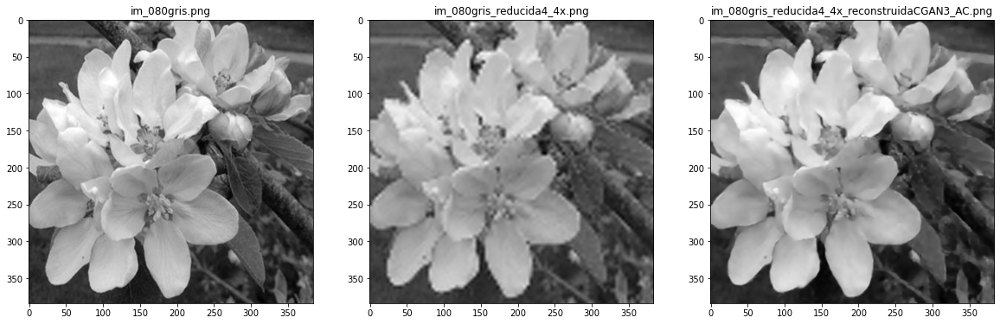

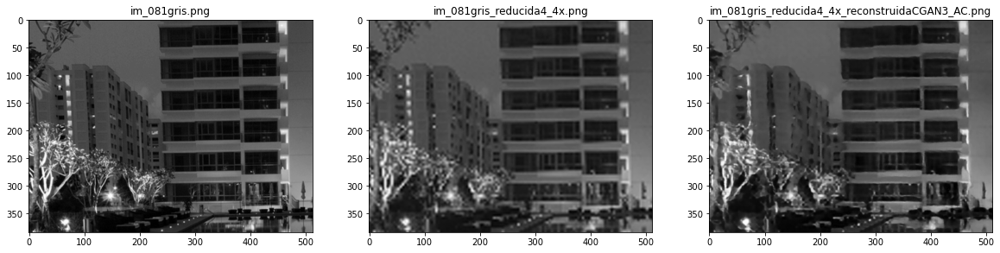

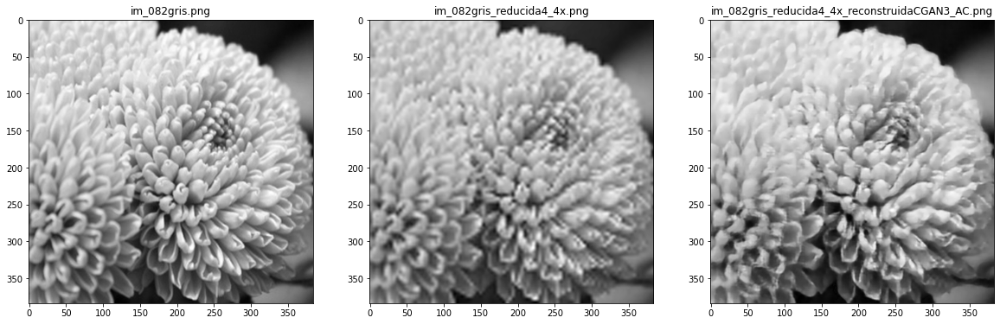

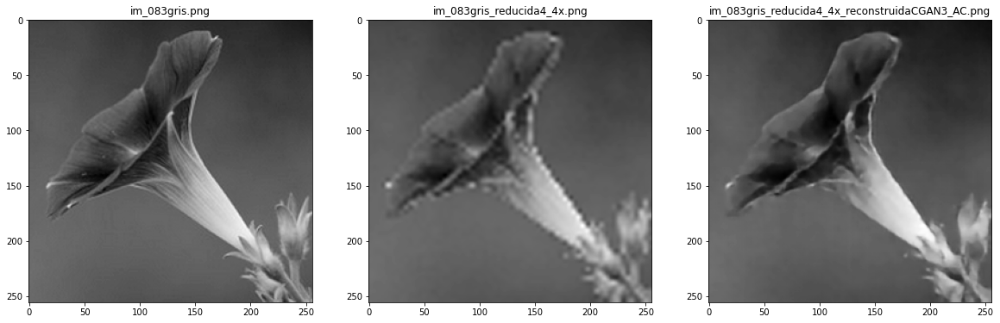

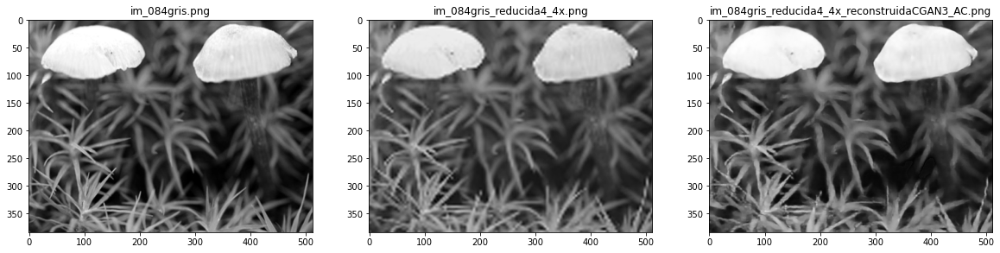

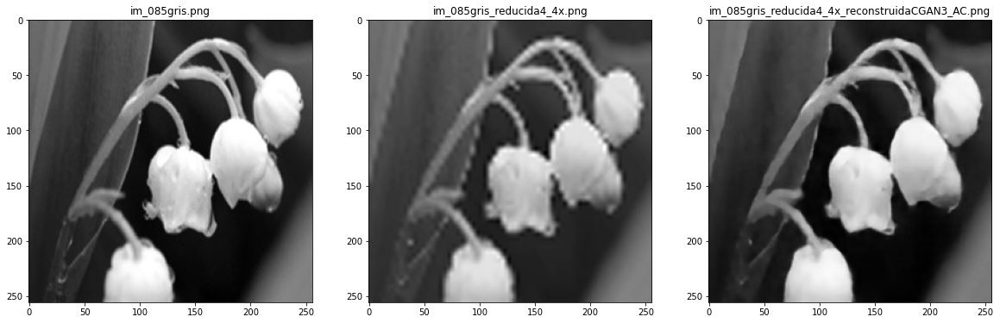

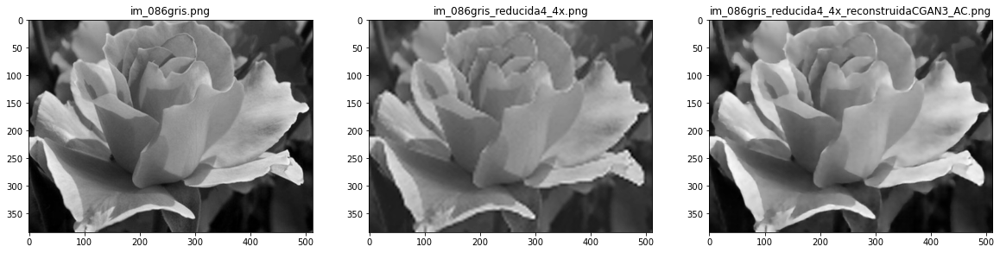

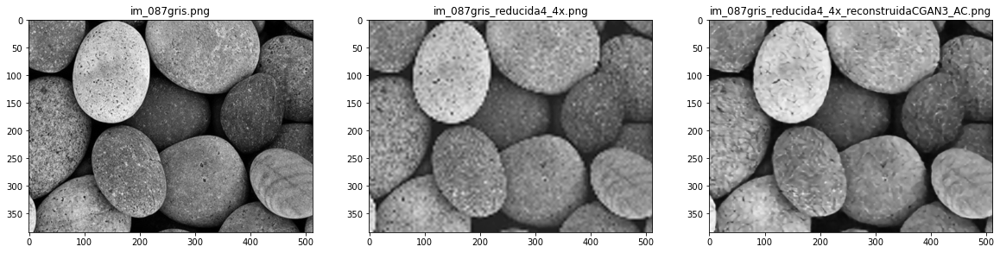

In [7]:
#mostrar_imagen_3f(80,88,'general100mod128','gris',
#                  'general100mod128','gris_reducida4_4x',
#                  'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')
mostrar_imagen_3f(80,88,'general100mod128','gris',
                  'general100mod128','gris_reducida4_4x',
                  'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')


D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


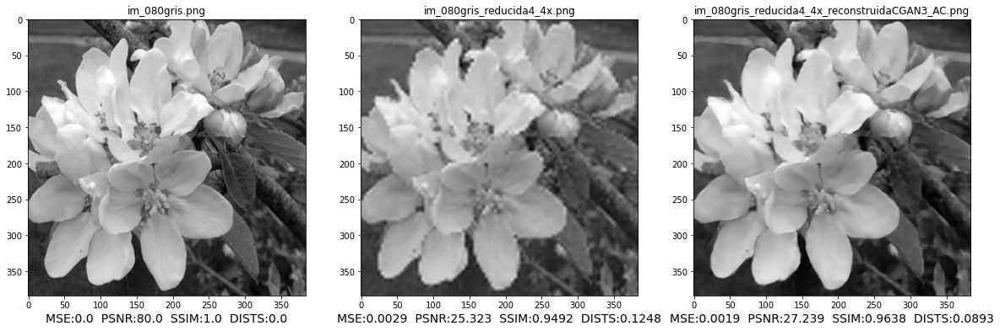

In [8]:
#De las 100 imagenes evaluar la similitud en las imágenes desde la 70 a la 100, y graficar la imagen 80
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(70,101,80,
                    'general100mod128','gris',
                    'general100mod128','gris_reducida4_4x',
                    'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')        


Promedio MSE baja resolución: 0.0055
Promedio MSE optimizada: 0.0048
Diferencia promedio de MSE: 0.0007


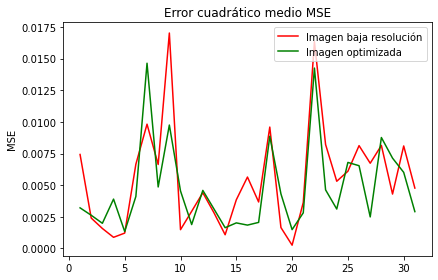

In [9]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 23.967
Promedio PSNR optimizada: 24.132
Diferencia promedio de PSNR: 0.165


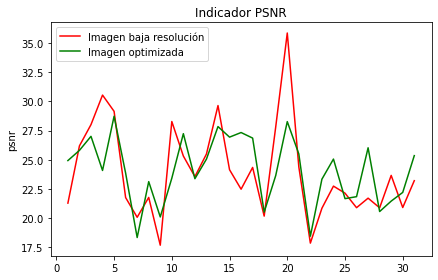

In [10]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.9037
Promedio SSIM optimizada: 0.9109
Diferencia promedio de SSIM: 0.0072


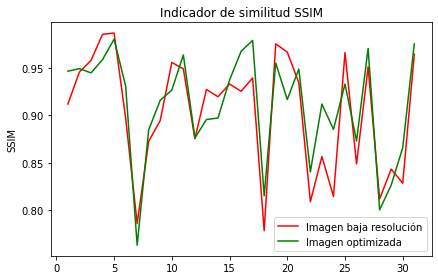

In [11]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1274
Promedio DISTS optimizada: 0.0864
Diferencia promedio de DISTS: 0.041


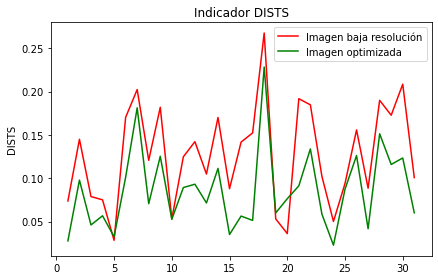

In [12]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba preliminar imágenes 4x color

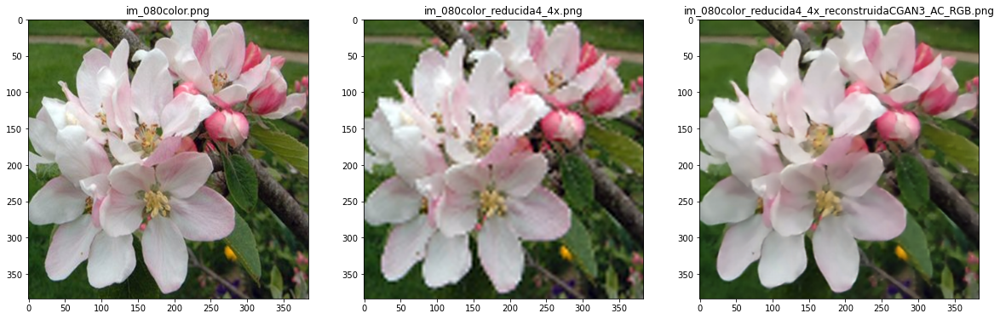

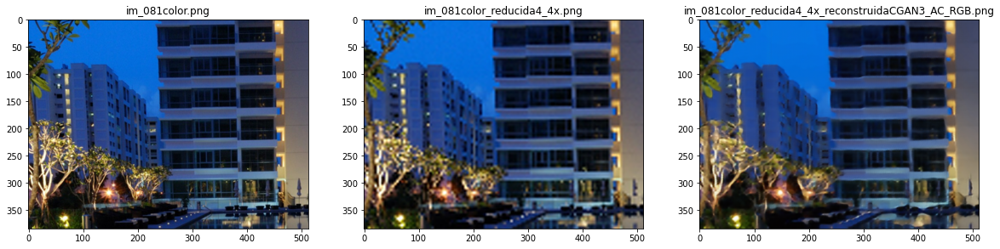

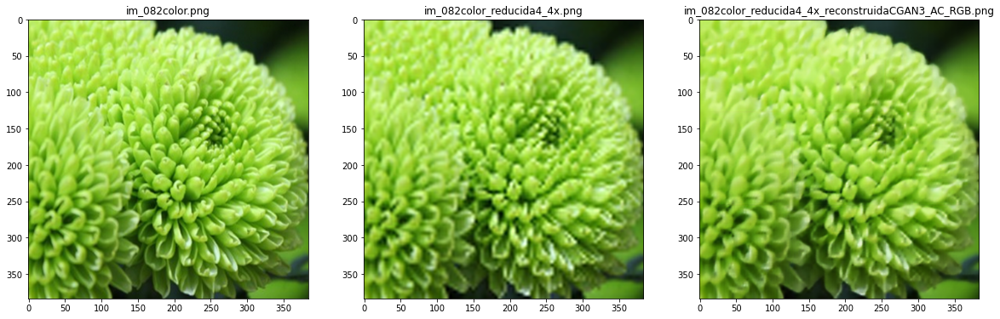

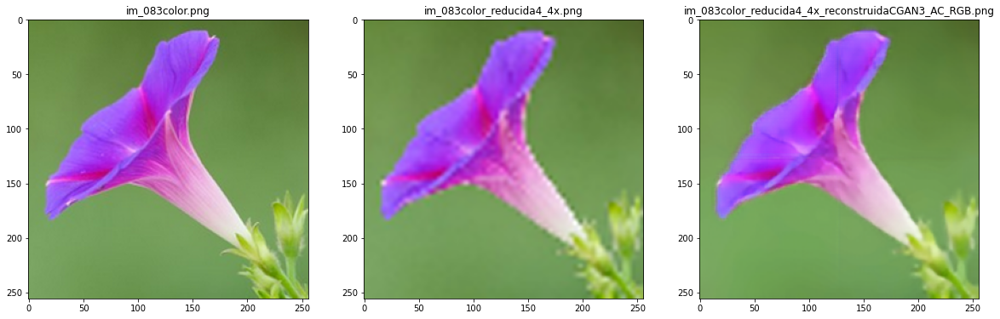

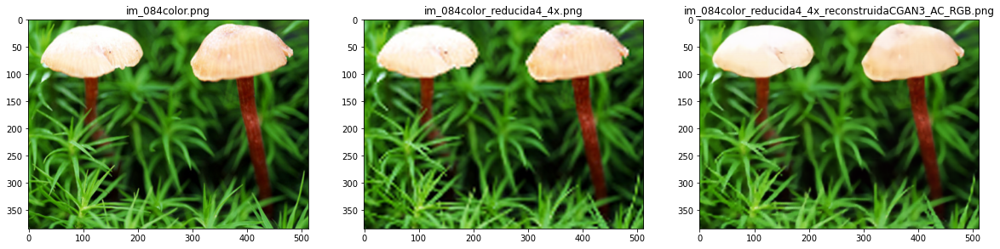

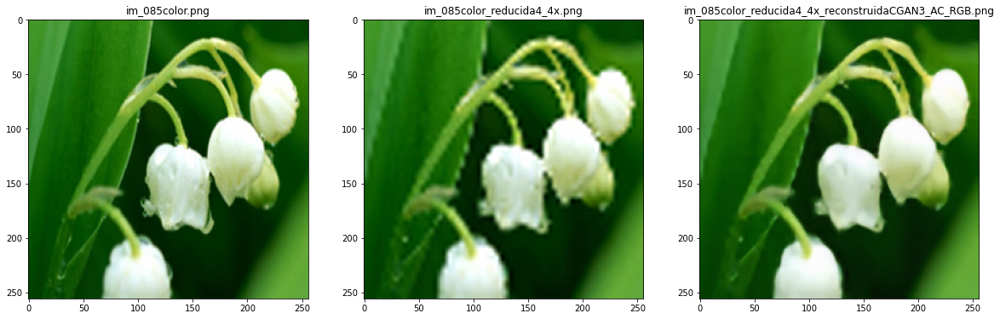

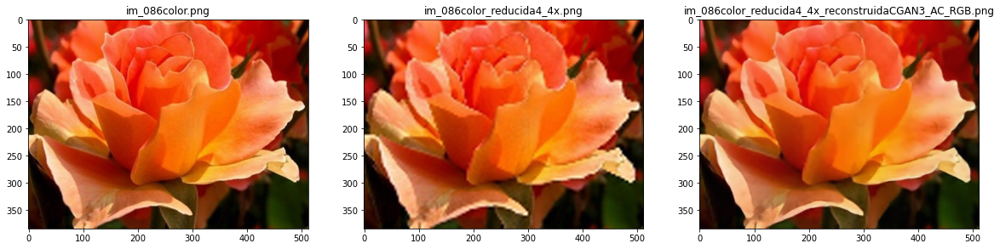

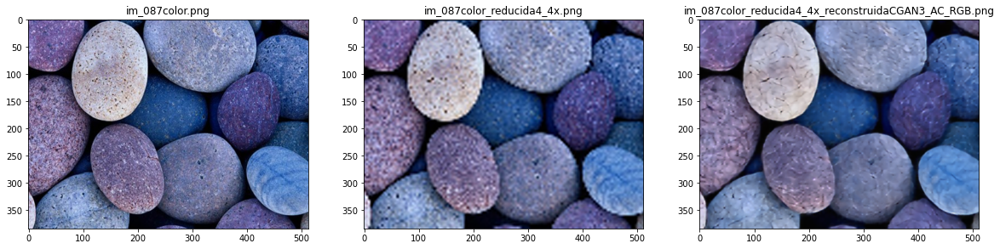

In [14]:
mostrar_imagen_3f_RGB(80,88,'general100mod128','color',
                  'general100mod128','color_reducida4_4x',
                  'general100resultado128','color_reducida4_4x_reconstruidaCGAN3_AC_RGB')


D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


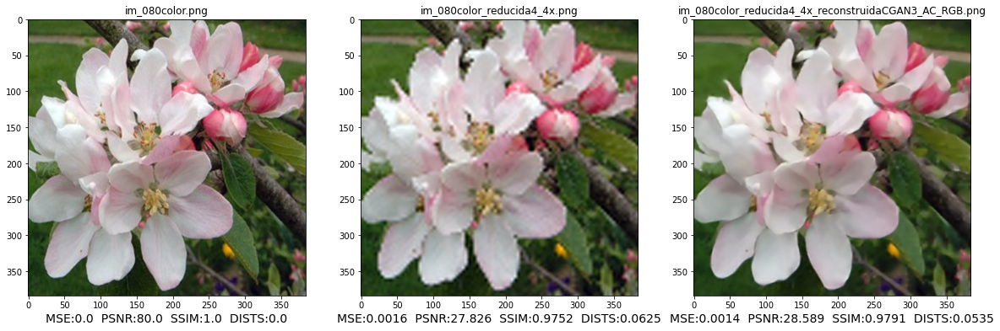

In [15]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud_RGB(70,101,80,
                    'general100mod128','color',
                    'general100mod128','color_reducida4_4x',
                    'general100resultado128','color_reducida4_4x_reconstruidaCGAN3_AC_RGB')   

Promedio MSE baja resolución: 0.0029
Promedio MSE optimizada: 0.0027
Diferencia promedio de MSE: 0.0001


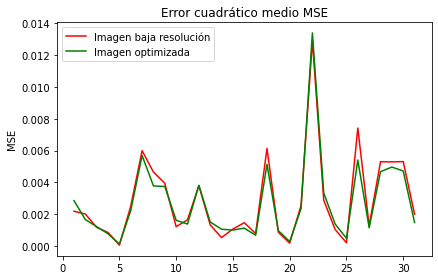

In [16]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 27.613
Promedio PSNR optimizada: 27.407
Diferencia promedio de PSNR: -0.206


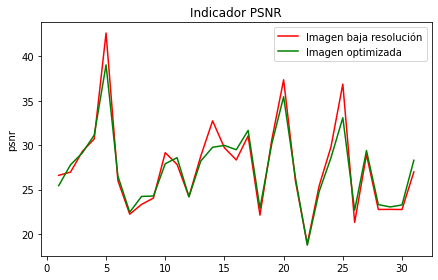

In [17]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.9653
Promedio SSIM optimizada: 0.9661
Diferencia promedio de SSIM: 0.0008


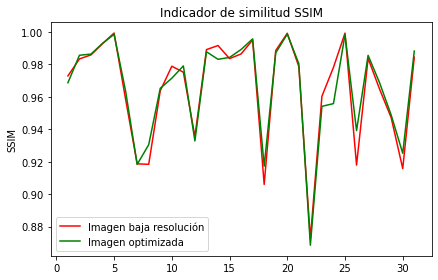

In [18]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.0594
Promedio DISTS optimizada: 0.0575
Diferencia promedio de DISTS: 0.002


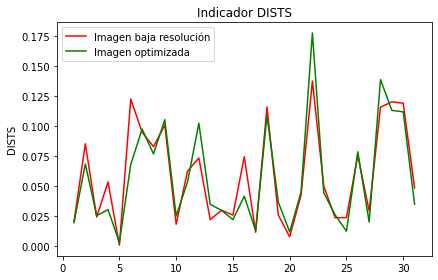

In [19]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Desmontar drive

In [ ]:
drive.flush_and_unmount()

# Prueba BSDS100

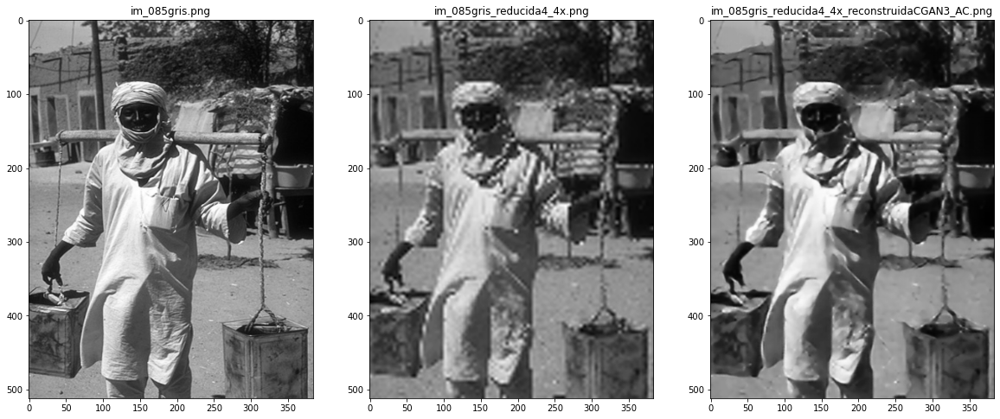

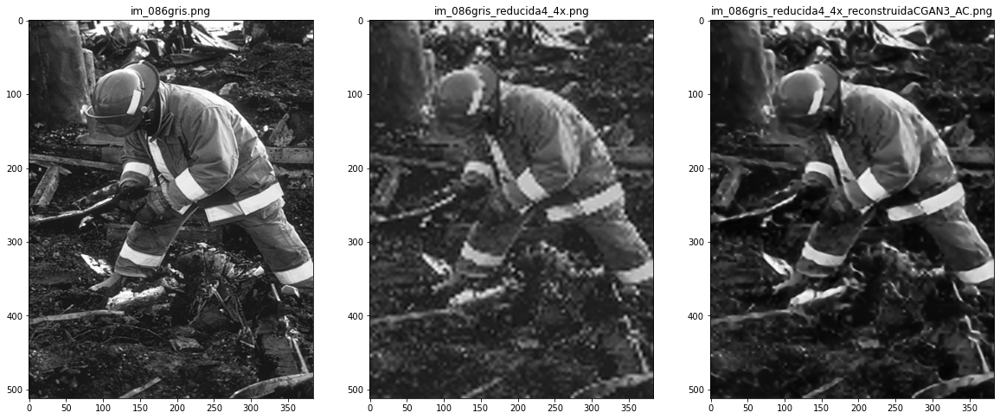

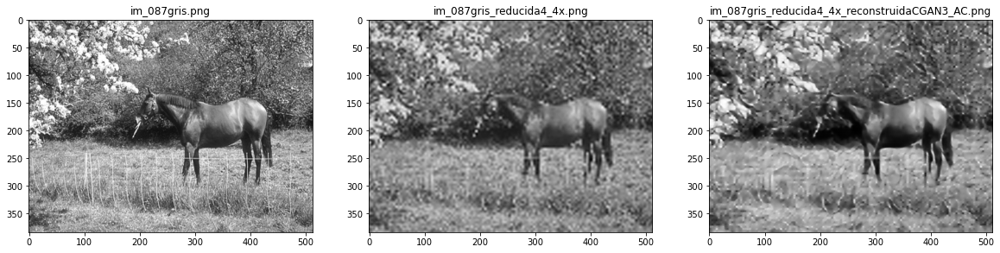

In [36]:
mostrar_imagen_3f(85,88,'pruebas/BSDS100mod128','gris',
                  'pruebas/BSDS100mod128','gris_reducida4_4x',
                  'pruebas/BSDS100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


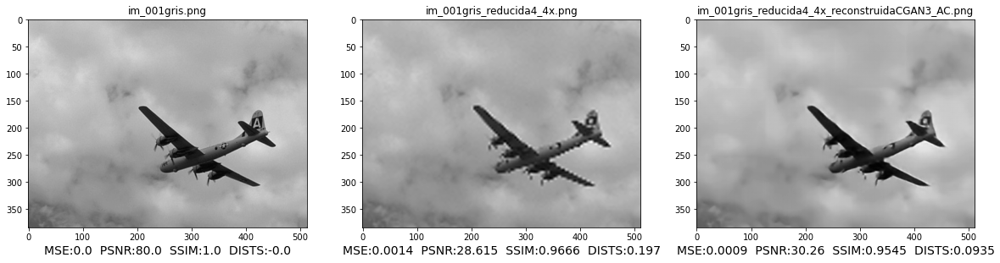

In [37]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,101,1,
                    'pruebas/BSDS100mod128','gris',
                    'pruebas/BSDS100mod128','gris_reducida4_4x',
                    'pruebas/BSDS100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

Promedio MSE baja resolución: 0.0077
Promedio MSE optimizada: 0.007
Diferencia promedio de MSE: 0.0007


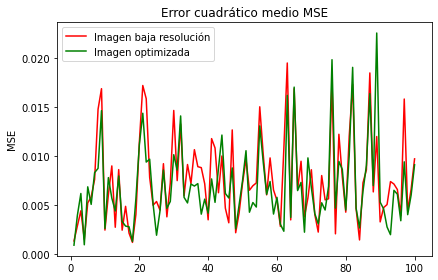

In [38]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 21.91
Promedio PSNR optimizada: 22.272
Diferencia promedio de PSNR: 0.362


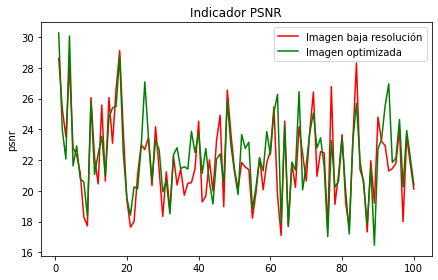

In [39]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8135
Promedio SSIM optimizada: 0.825
Diferencia promedio de SSIM: 0.0115


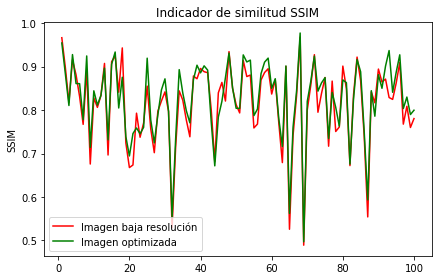

In [40]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1965
Promedio DISTS optimizada: 0.1666
Diferencia promedio de DISTS: 0.0299


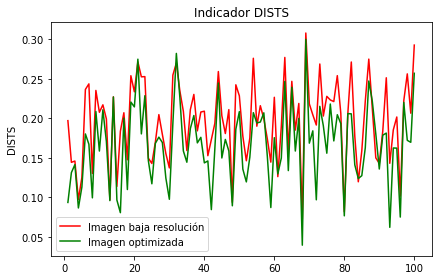

In [41]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba Historicas40

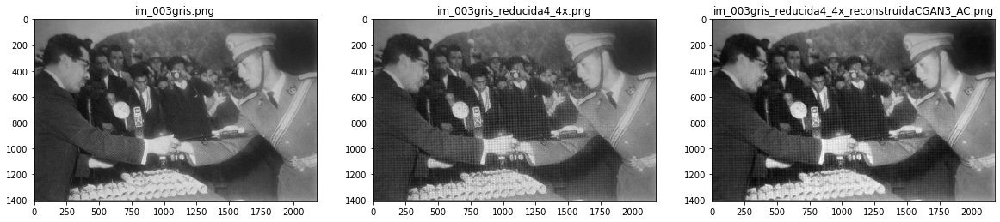

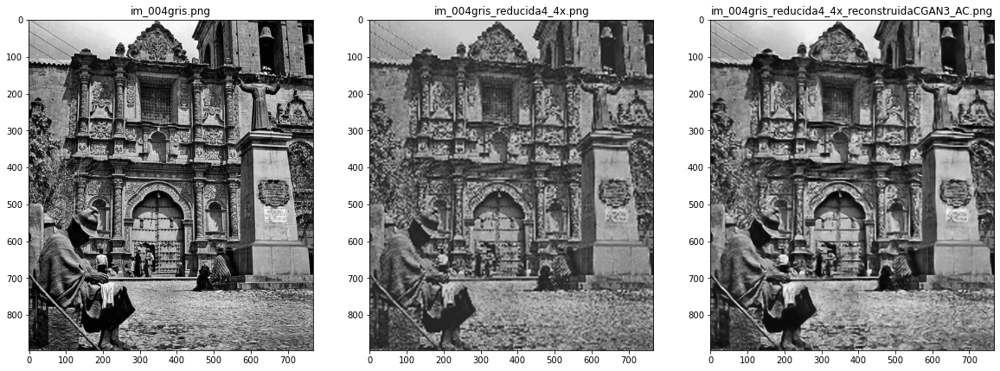

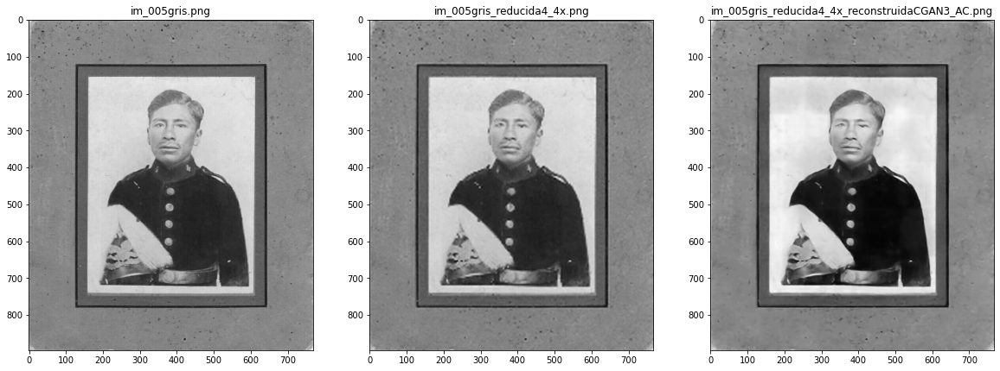

In [30]:
mostrar_imagen_3f(3,6,'pruebas/Historicas40mod128','gris',
                  'pruebas/Historicas40mod128','gris_reducida4_4x',
                  'pruebas/Historicas40resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


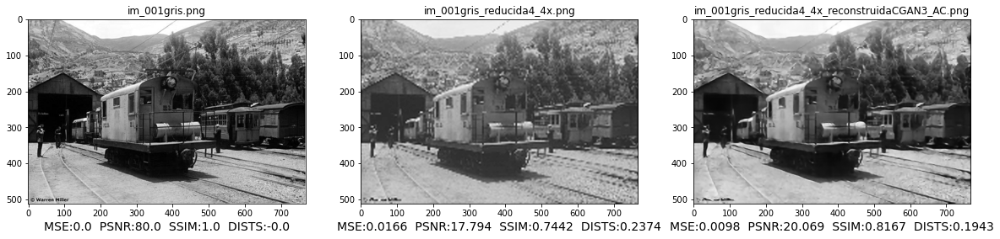

In [31]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,41,1,
                    'pruebas/Historicas40mod128','gris',
                    'pruebas/Historicas40mod128','gris_reducida4_4x',
                    'pruebas/Historicas40resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

Promedio MSE baja resolución: 0.0139
Promedio MSE optimizada: 0.0087
Diferencia promedio de MSE: 0.0052


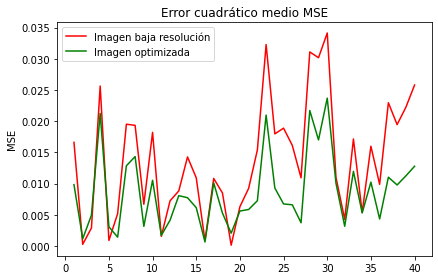

In [32]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 20.472
Promedio PSNR optimizada: 21.798
Diferencia promedio de PSNR: 1.326


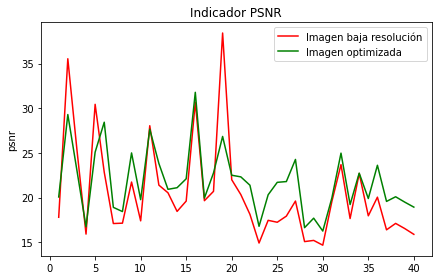

In [33]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8248
Promedio SSIM optimizada: 0.8592
Diferencia promedio de SSIM: 0.0344


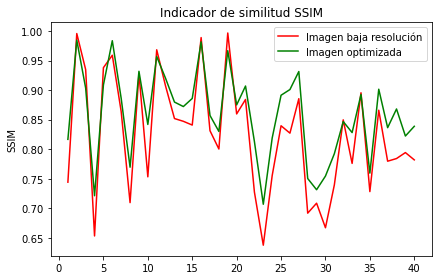

In [34]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1769
Promedio DISTS optimizada: 0.137
Diferencia promedio de DISTS: 0.0399


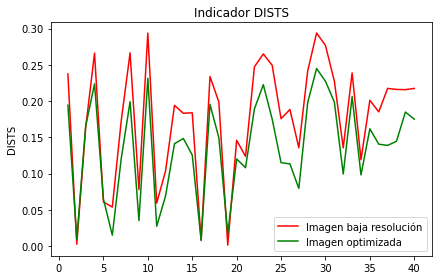

In [35]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba Manga109

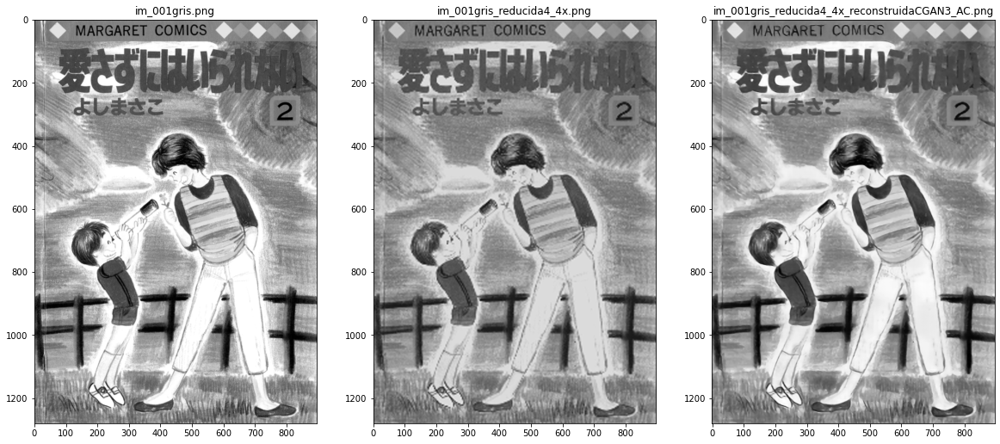

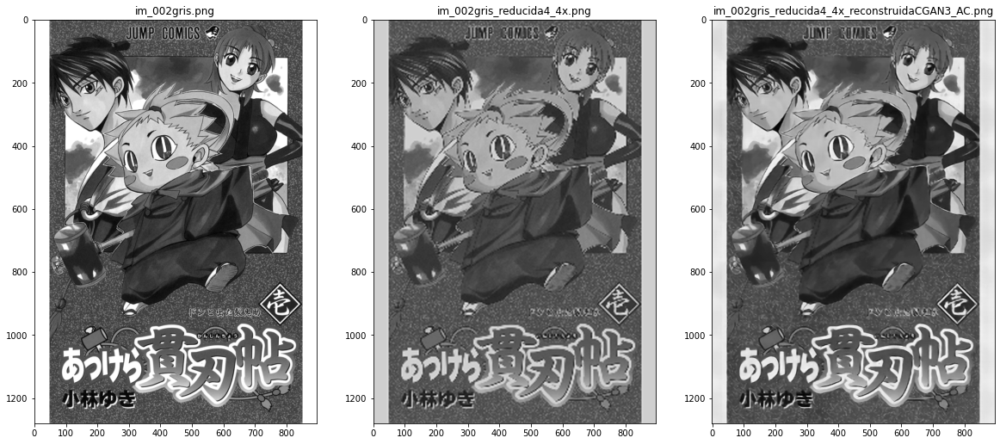

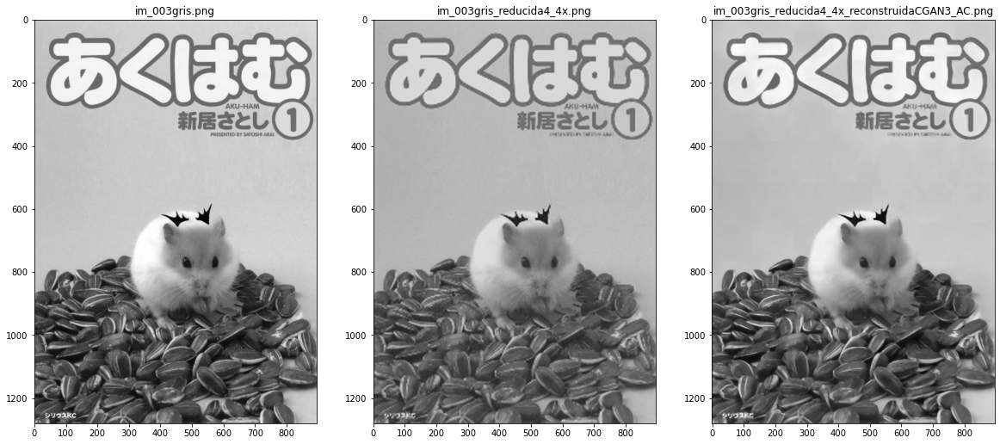

In [24]:
mostrar_imagen_3f(1,4,'pruebas/Manga109mod128','gris',
                  'pruebas/Manga109mod128','gris_reducida4_4x',
                  'pruebas/Manga109resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


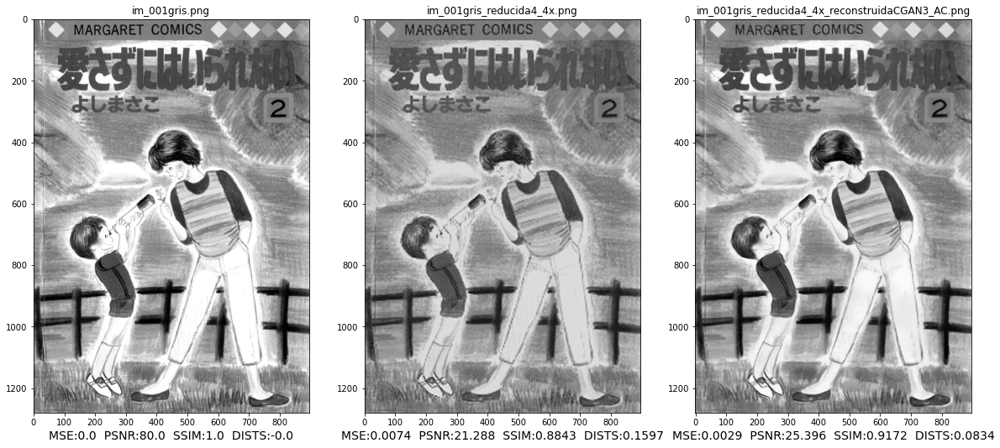

In [25]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,110,1,
                    'pruebas/Manga109mod128','gris',
                    'pruebas/Manga109mod128','gris_reducida4_4x',
                    'pruebas/Manga109resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

Promedio MSE baja resolución: 0.0157
Promedio MSE optimizada: 0.0078
Diferencia promedio de MSE: 0.0079


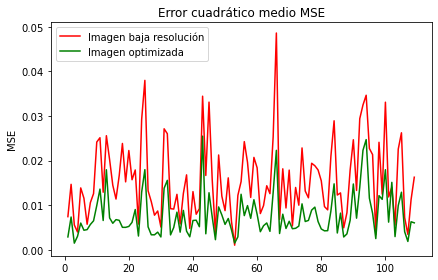

In [26]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 18.769
Promedio PSNR optimizada: 21.872
Diferencia promedio de PSNR: 3.103


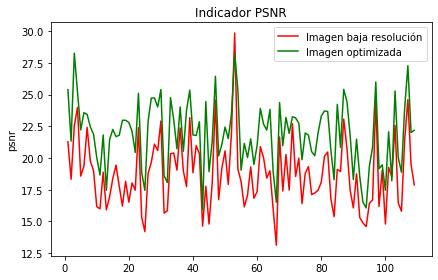

In [27]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8433
Promedio SSIM optimizada: 0.8878
Diferencia promedio de SSIM: 0.0445


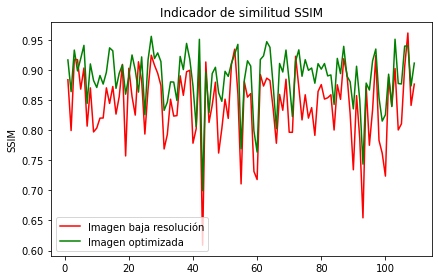

In [28]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.2093
Promedio DISTS optimizada: 0.1127
Diferencia promedio de DISTS: 0.0966


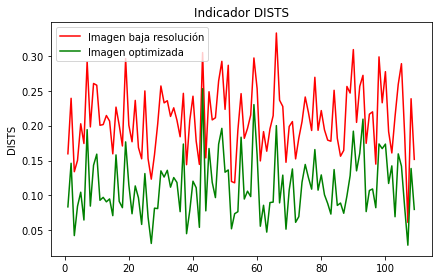

In [29]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba Set5

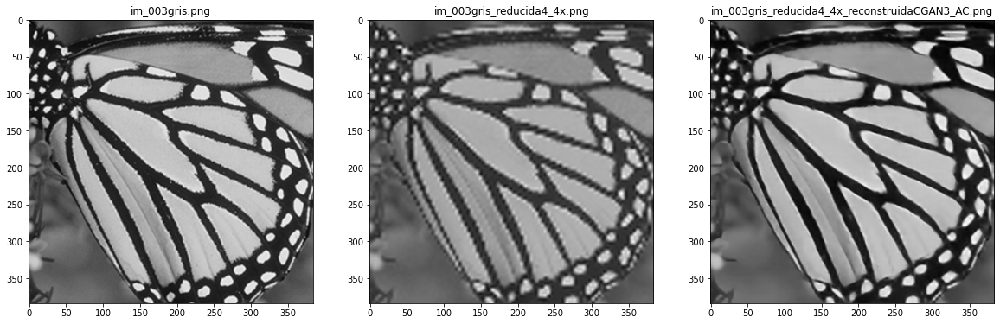

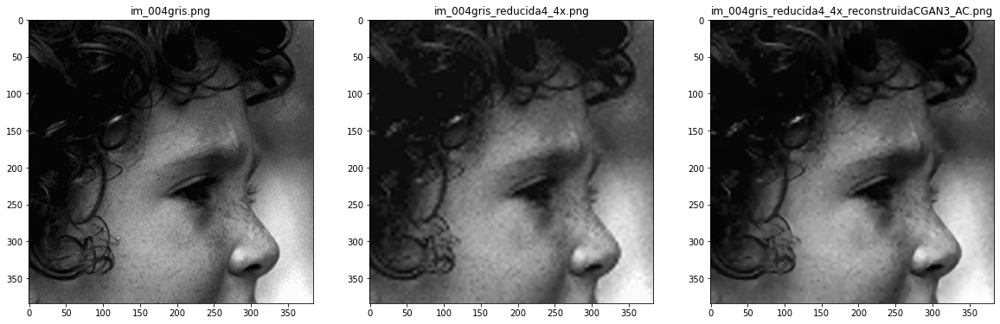

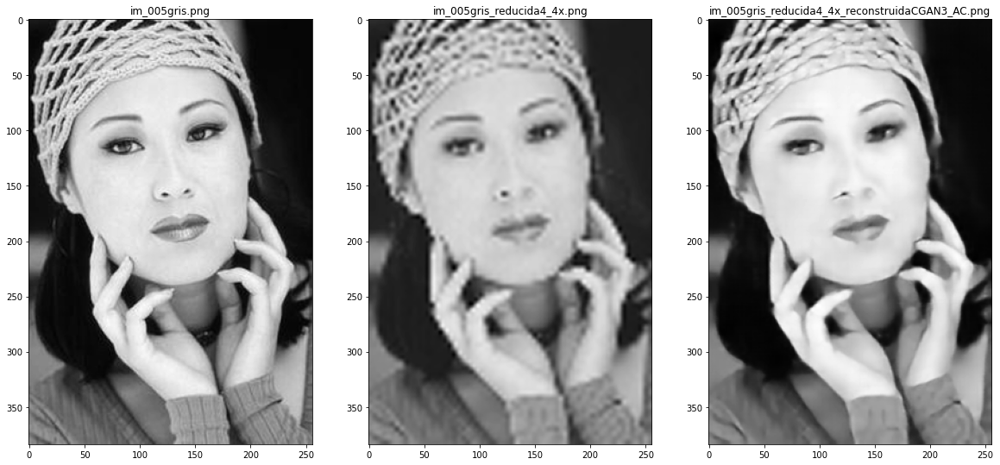

In [18]:
mostrar_imagen_3f(3,6,'pruebas/Set5mod128','gris',
                  'pruebas/Set5mod128','gris_reducida4_4x',
                  'pruebas/Set5resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


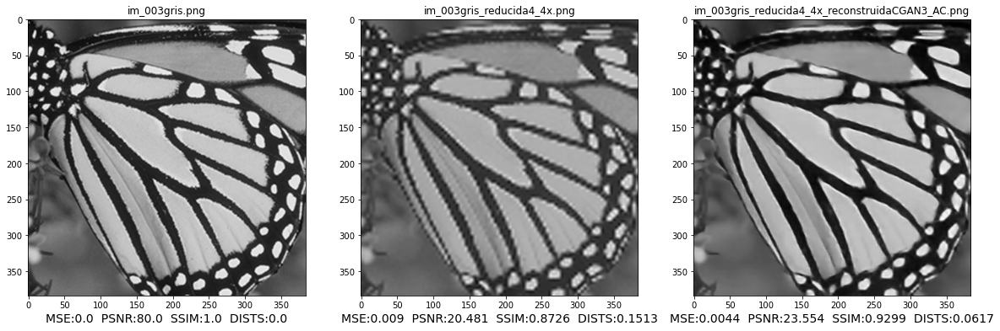

In [19]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,6,3,
                    'pruebas/Set5mod128','gris',
                    'pruebas/Set5mod128','gris_reducida4_4x',
                    'pruebas/Set5resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')        


Promedio MSE baja resolución: 0.0041
Promedio MSE optimizada: 0.0023
Diferencia promedio de MSE: 0.0018


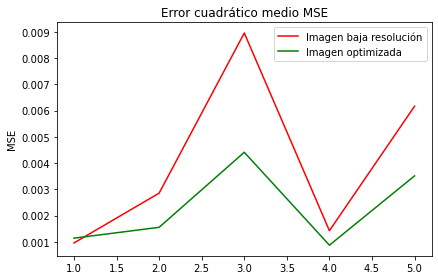

In [20]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 25.33
Promedio PSNR optimizada: 27.234
Diferencia promedio de PSNR: 1.904


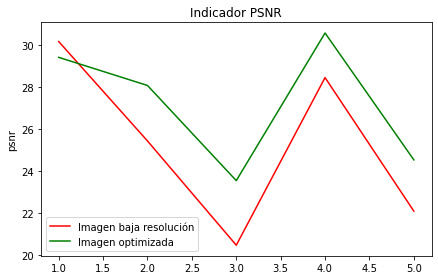

In [21]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.9356
Promedio SSIM optimizada: 0.9579
Diferencia promedio de SSIM: 0.0223


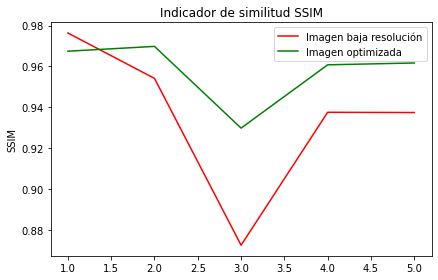

In [22]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.0748
Promedio DISTS optimizada: 0.0381
Diferencia promedio de DISTS: 0.0367


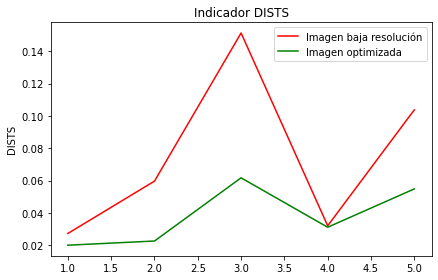

In [23]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba Set14

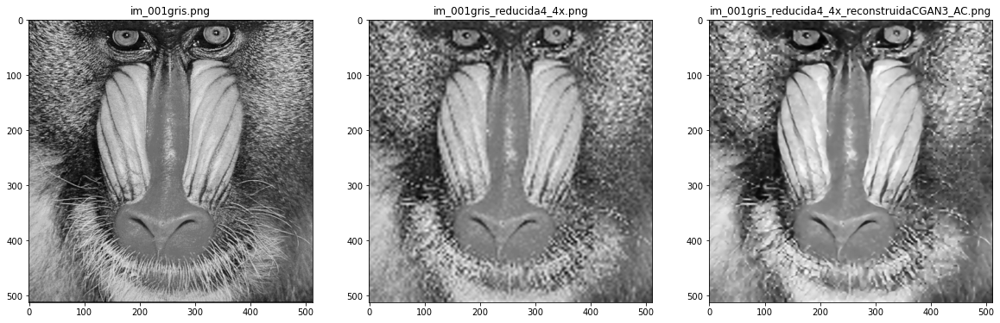

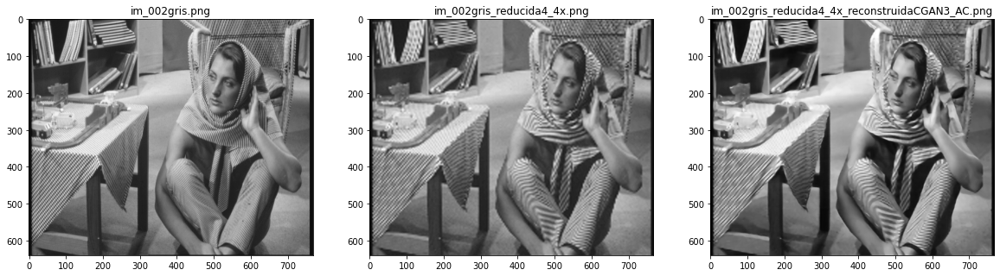

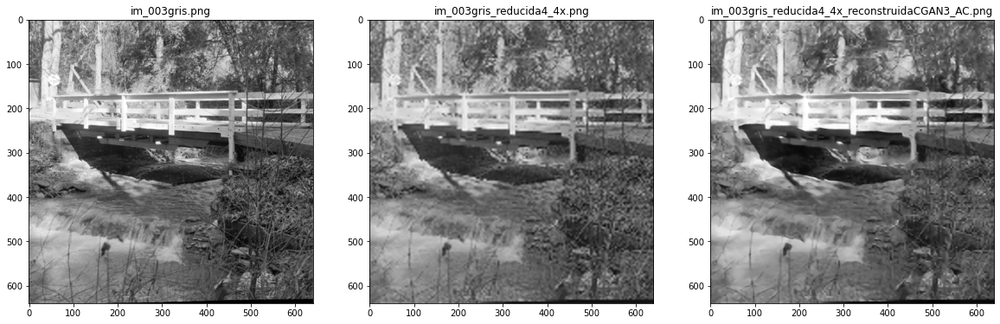

In [12]:
mostrar_imagen_3f(1,4,'pruebas/Set14mod128','gris',
                  'pruebas/Set14mod128','gris_reducida4_4x',
                  'pruebas/Set14resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


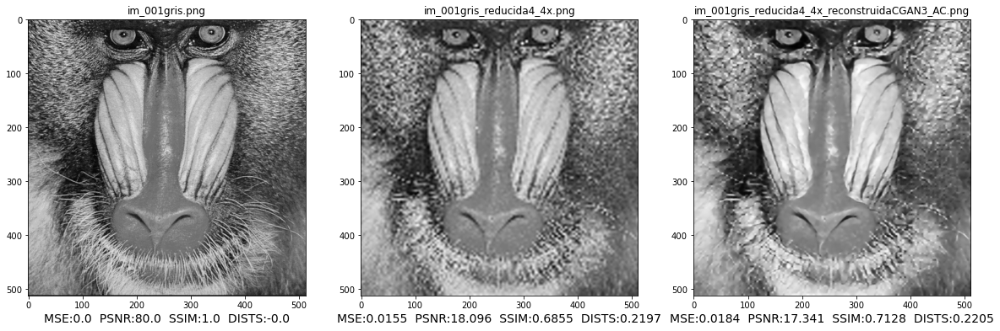

In [13]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,15,1,
                    'pruebas/Set14mod128','gris',
                    'pruebas/Set14mod128','gris_reducida4_4x',
                    'pruebas/Set14resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

Promedio MSE baja resolución: 0.0093
Promedio MSE optimizada: 0.0073
Diferencia promedio de MSE: 0.002


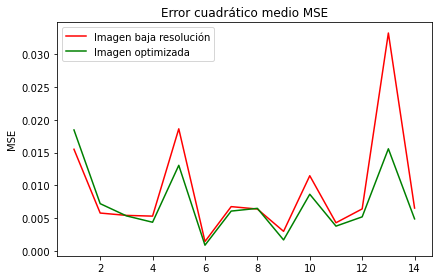

In [14]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 21.57
Promedio PSNR optimizada: 22.494
Diferencia promedio de PSNR: 0.924


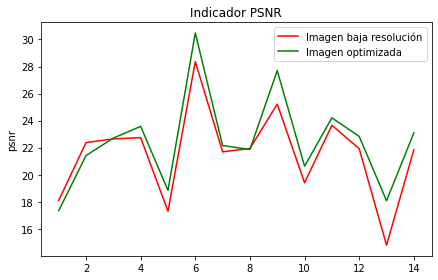

In [15]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8482
Promedio SSIM optimizada: 0.8704
Diferencia promedio de SSIM: 0.0221


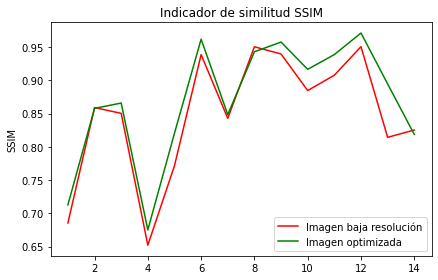

In [16]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1784
Promedio DISTS optimizada: 0.131
Diferencia promedio de DISTS: 0.0474


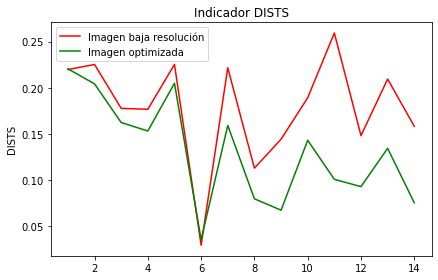

In [17]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba Urban100

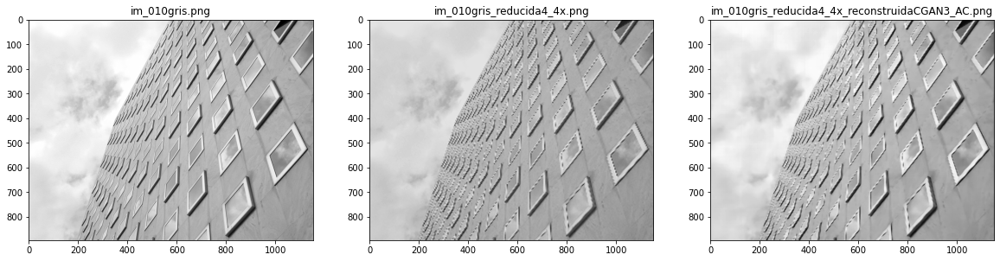

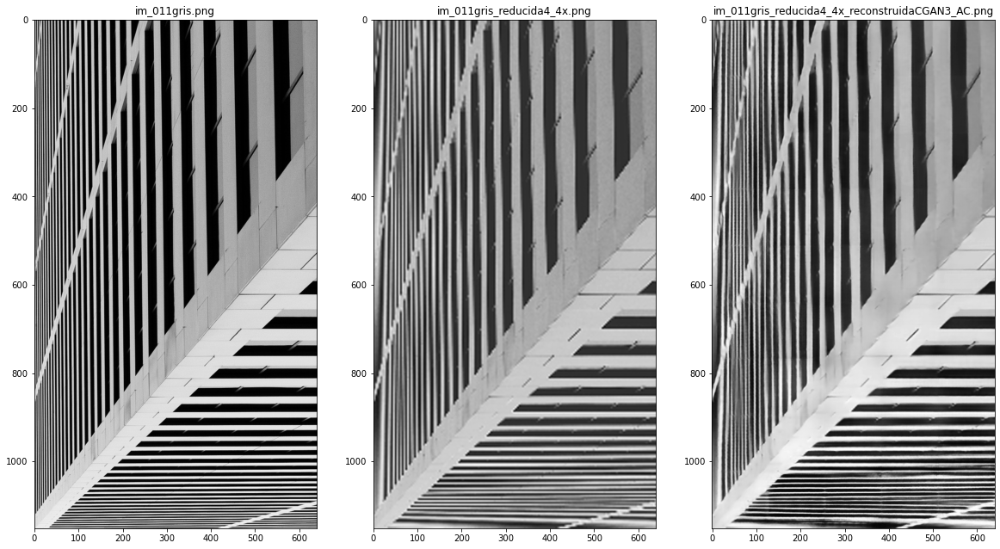

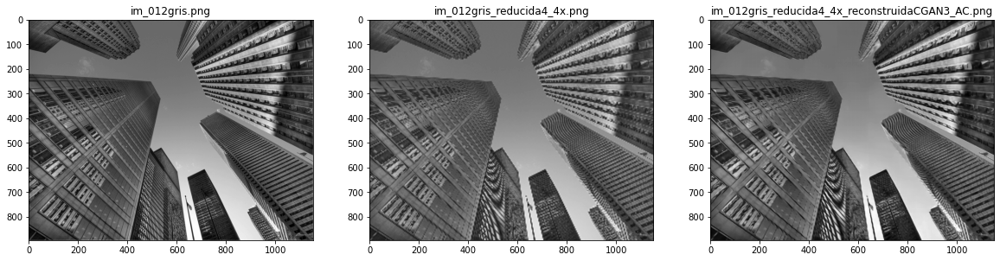

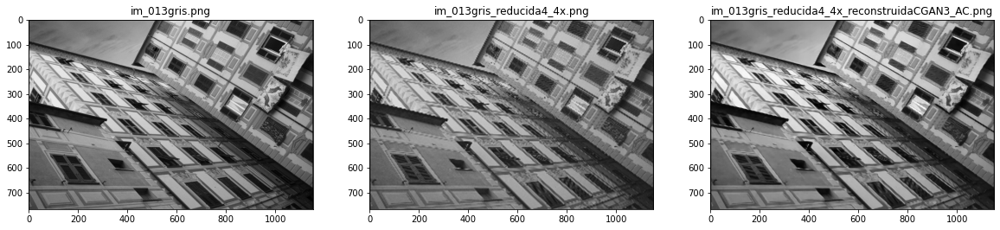

In [6]:
mostrar_imagen_3f(10,14,'pruebas/Urban100mod128','gris',
                  'pruebas/Urban100mod128','gris_reducida4_4x',
                  'pruebas/Urban100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


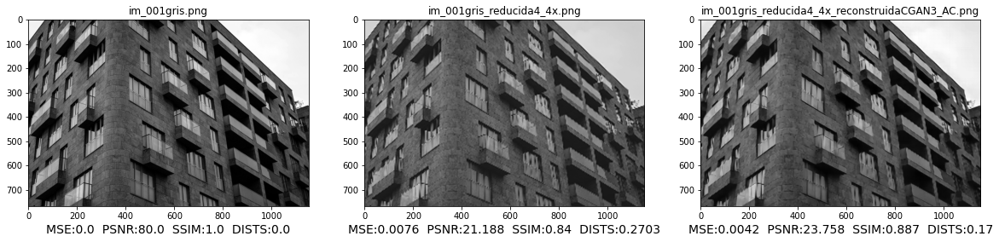

In [7]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,101,1,
                    'pruebas/Urban100mod128','gris',
                    'pruebas/Urban100mod128','gris_reducida4_4x',
                    'pruebas/Urban100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC') 

Promedio MSE baja resolución: 0.013
Promedio MSE optimizada: 0.0093
Diferencia promedio de MSE: 0.0037


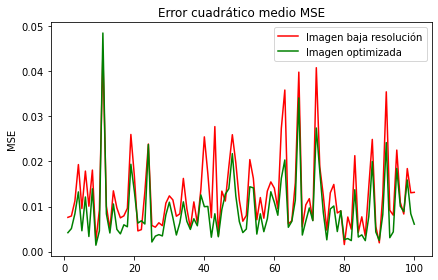

In [8]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 19.715
Promedio PSNR optimizada: 21.328
Diferencia promedio de PSNR: 1.613


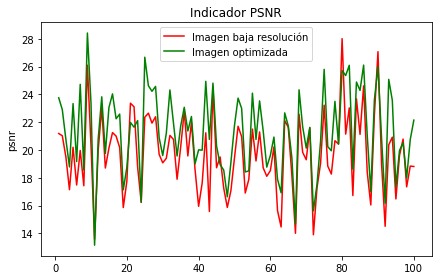

In [9]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.7881
Promedio SSIM optimizada: 0.839
Diferencia promedio de SSIM: 0.0509


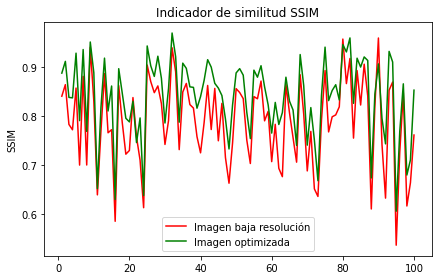

In [10]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.2293
Promedio DISTS optimizada: 0.1627
Diferencia promedio de DISTS: 0.0665


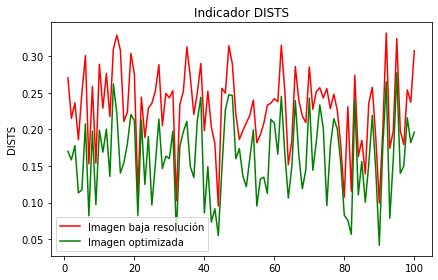

In [11]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba ESRGAN BSDS100

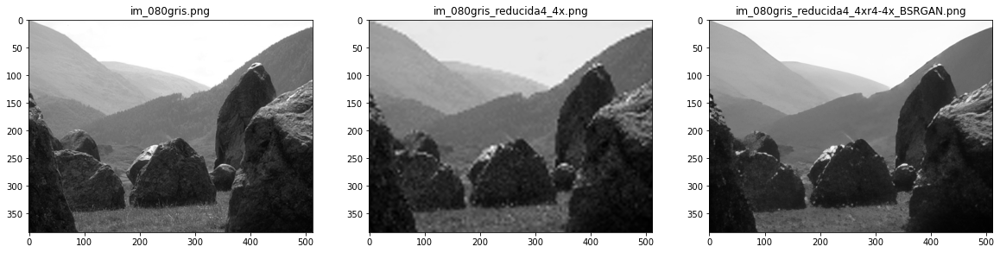

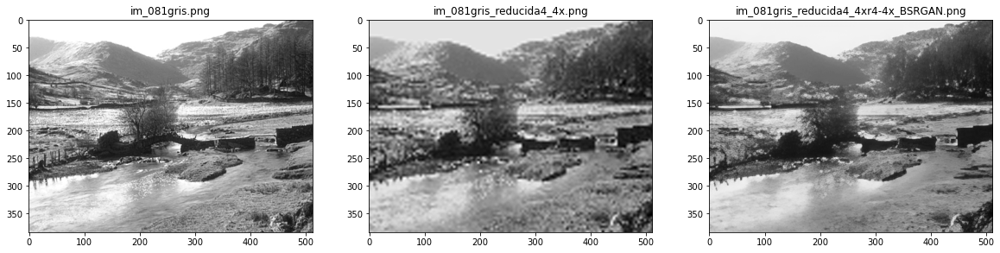

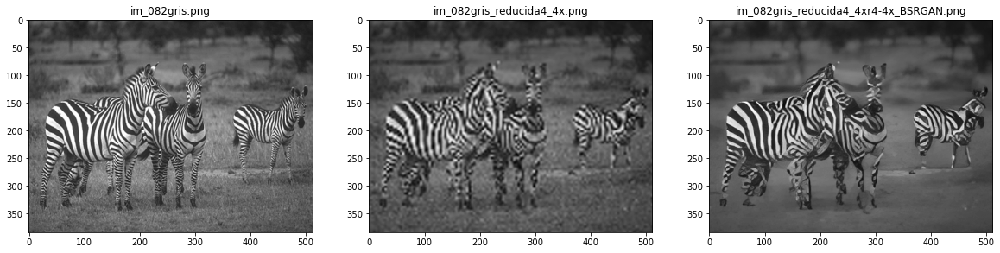

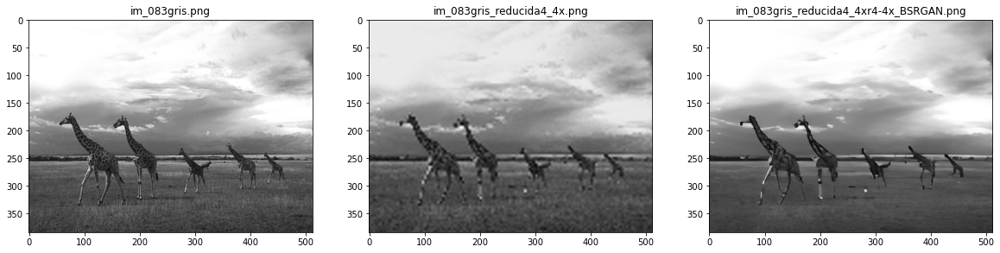

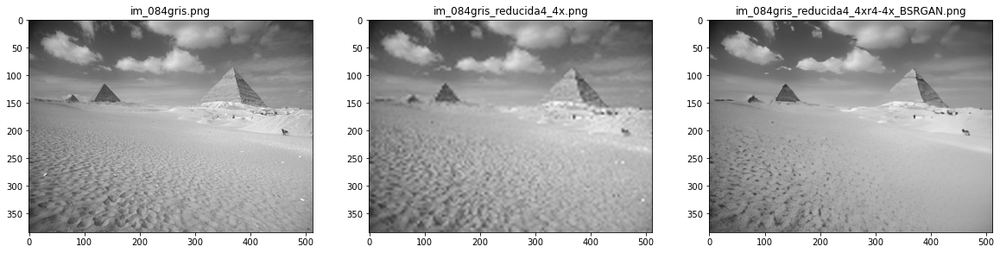

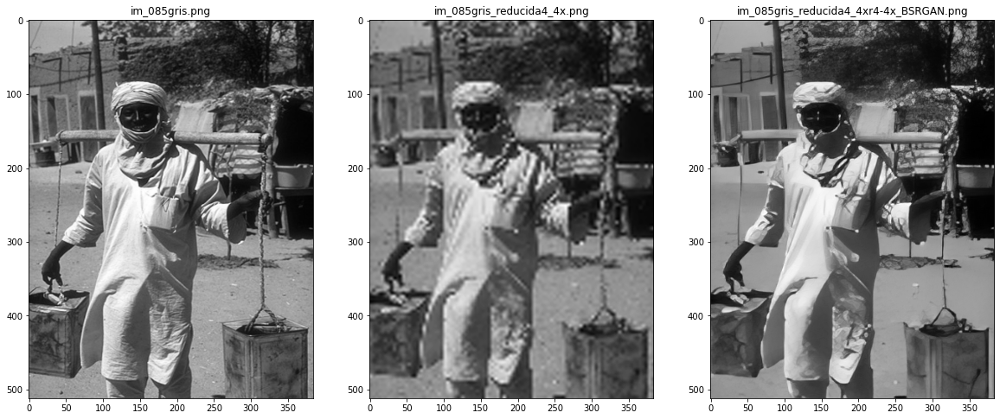

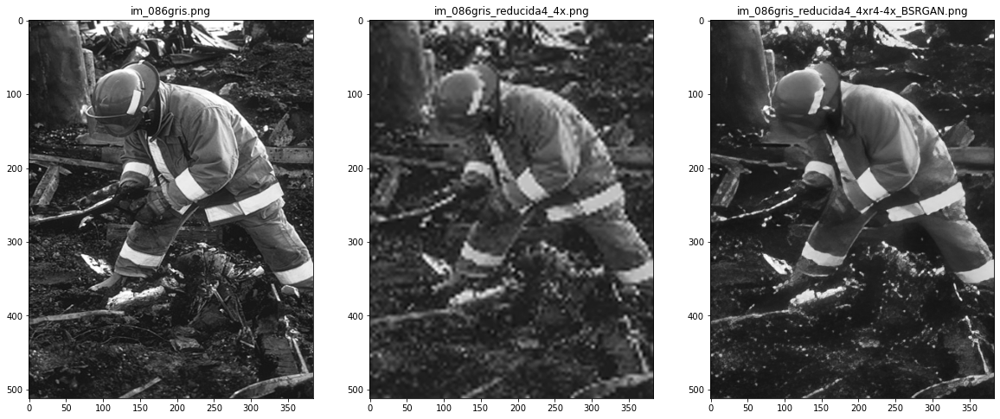

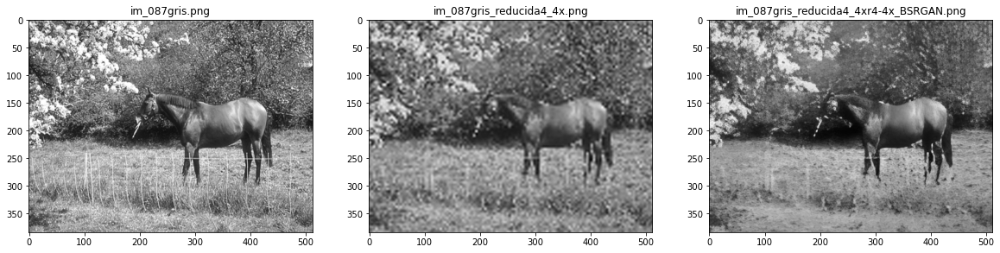

In [58]:
mostrar_imagen_3f(80,88,'pruebas/BSDS100mod128','gris',
                  'pruebas/BSDS100mod128','gris_reducida4_4x',
                  'pruebasSRGAN/BSDS100resultado128','gris_reducida4_4xr4-4x_BSRGAN')

1


D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100


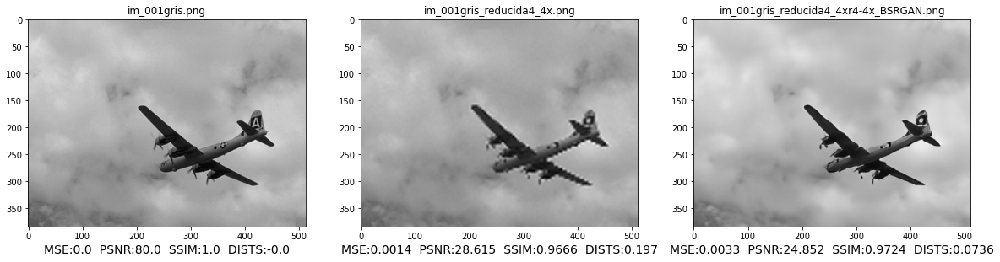

In [69]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,101,1,
                    'pruebas/BSDS100mod128','gris',
                    'pruebas/BSDS100mod128','gris_reducida4_4x',
                    'pruebasSRGAN/BSDS100resultado128','gris_reducida4_4xr4-4x_BSRGAN')    

Promedio MSE baja resolución: 0.0077
Promedio MSE optimizada: 0.0072
Diferencia promedio de MSE: 0.0004


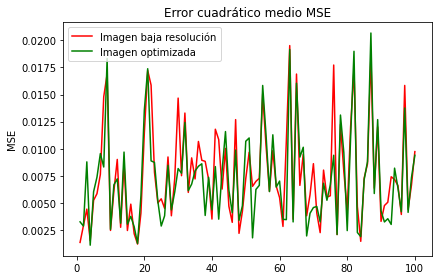

In [70]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 21.91
Promedio PSNR optimizada: 22.174
Diferencia promedio de PSNR: 0.264


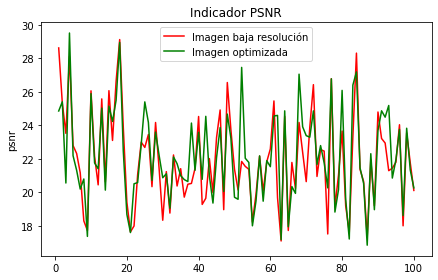

In [71]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8135
Promedio SSIM optimizada: 0.8032
Diferencia promedio de SSIM: -0.0103


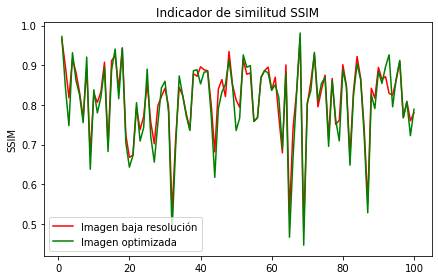

In [72]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1965
Promedio DISTS optimizada: 0.1059
Diferencia promedio de DISTS: 0.0906


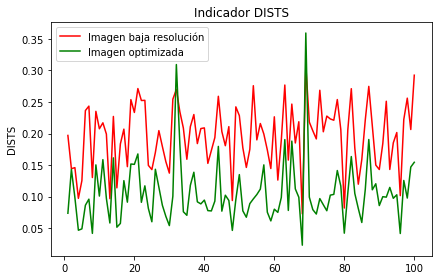

In [73]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba ESRGAN Historicas40

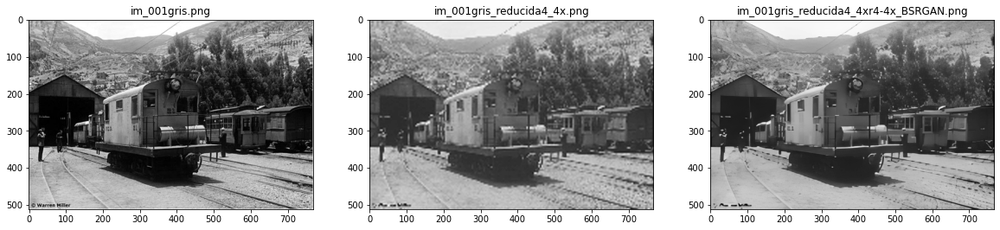

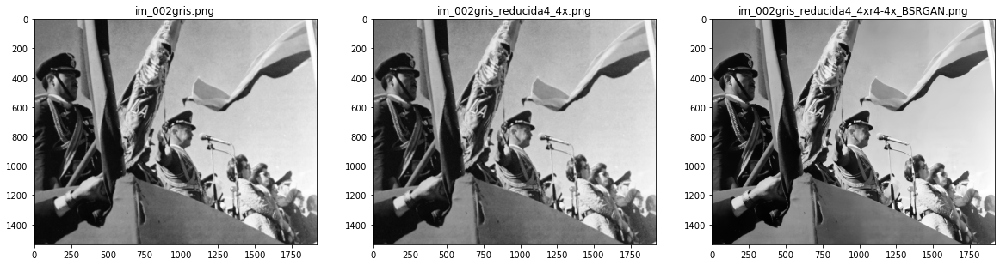

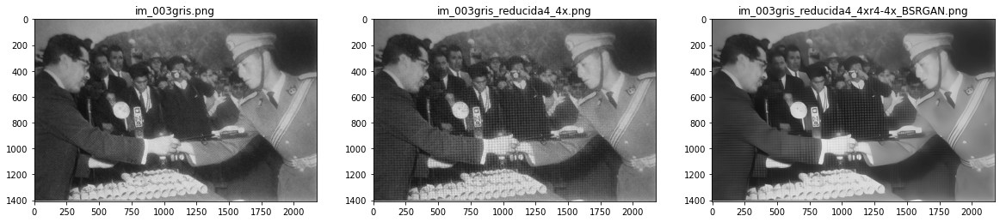

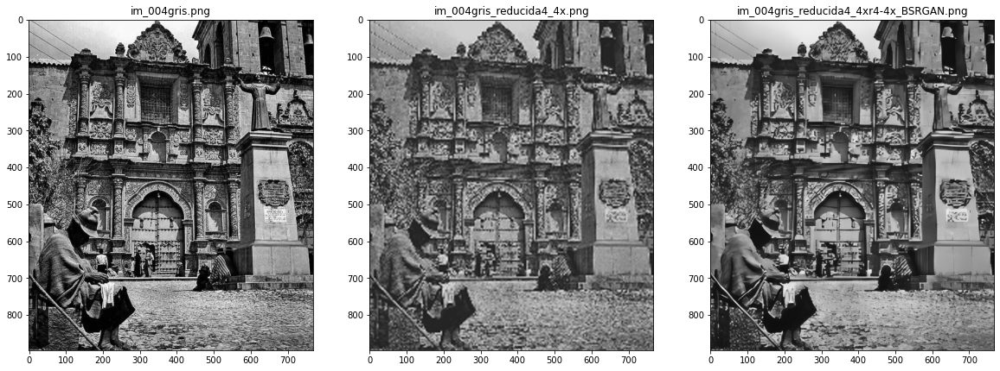

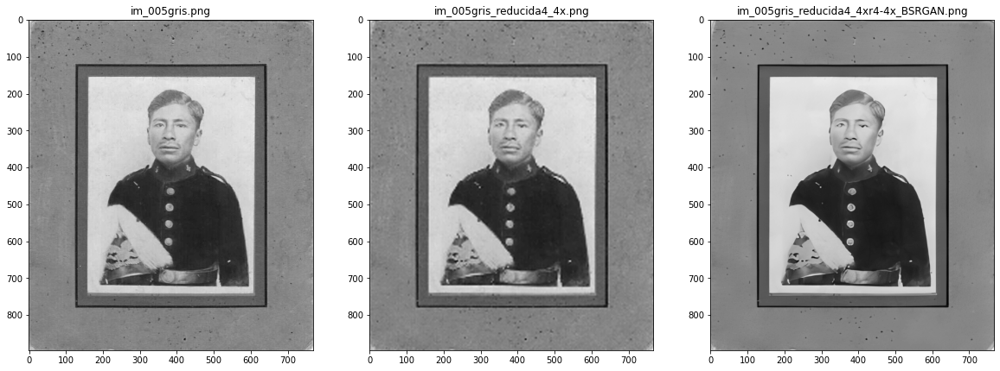

In [48]:
mostrar_imagen_3f(1,6,'pruebas/Historicas40mod128','gris',
                  'pruebas/Historicas40mod128','gris_reducida4_4x',
                  'pruebasSRGAN/Historicas40resultado128','gris_reducida4_4xr4-4x_BSRGAN')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


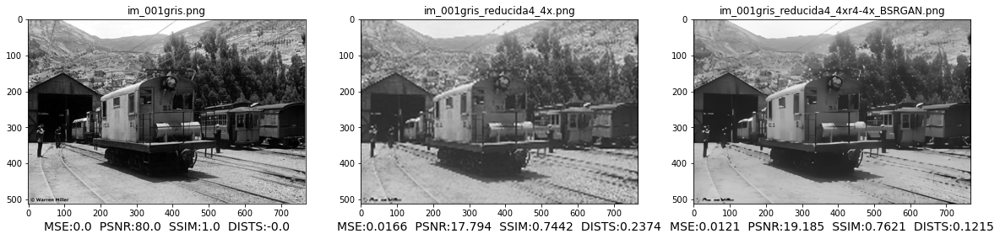

In [49]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,41,1,
                    'pruebas/Historicas40mod128','gris',
                    'pruebas/Historicas40mod128','gris_reducida4_4x',
                    'pruebasSRGAN/Historicas40resultado128','gris_reducida4_4xr4-4x_BSRGAN')

Promedio MSE baja resolución: 0.0139
Promedio MSE optimizada: 0.0099
Diferencia promedio de MSE: 0.004


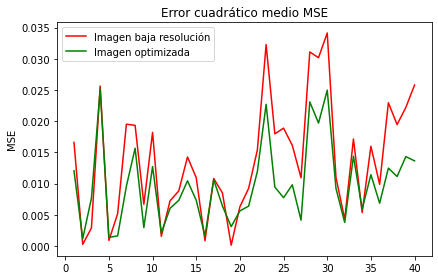

In [50]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 20.472
Promedio PSNR optimizada: 21.18
Diferencia promedio de PSNR: 0.708


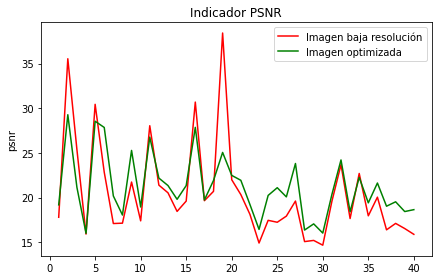

In [51]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8248
Promedio SSIM optimizada: 0.8441
Diferencia promedio de SSIM: 0.0193


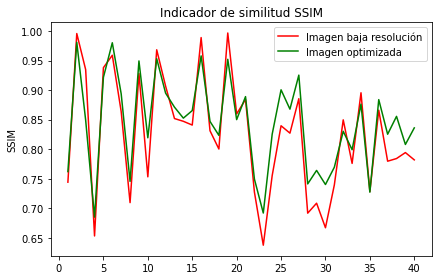

In [52]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1769
Promedio DISTS optimizada: 0.1142
Diferencia promedio de DISTS: 0.0627


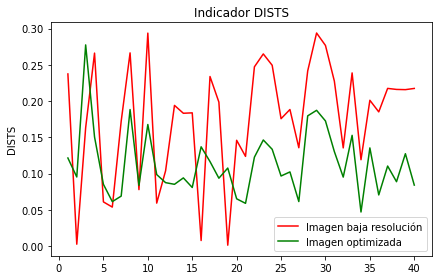

In [53]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba ESRGAN Manga109

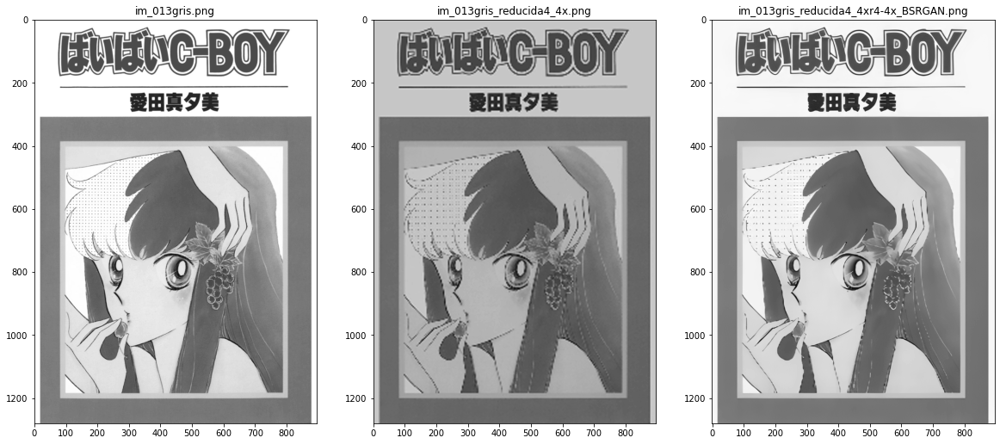

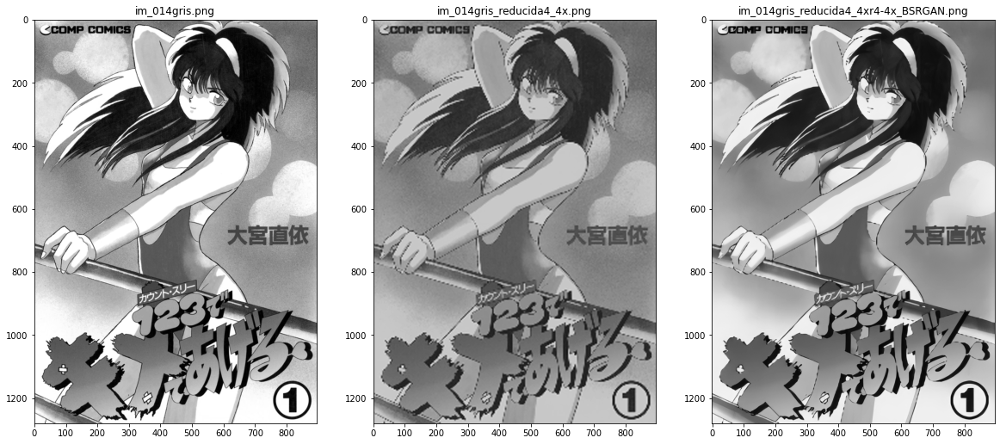

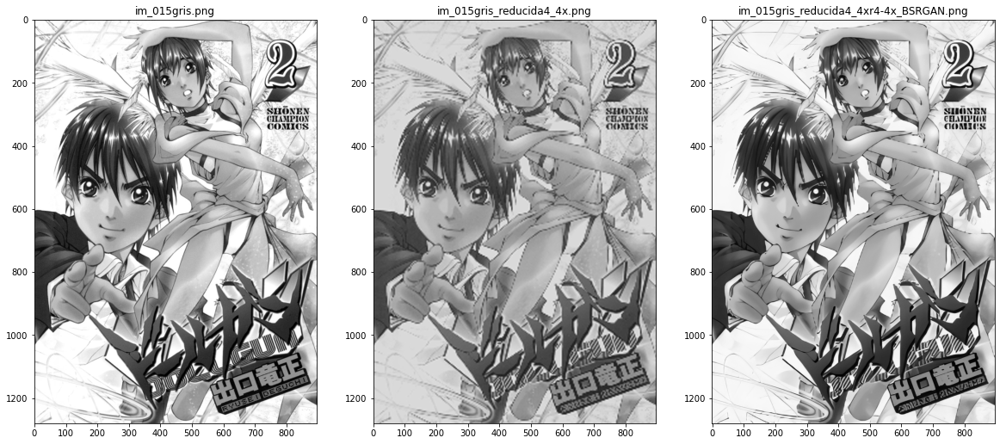

In [23]:
mostrar_imagen_3f(13,16,'pruebas/Manga109mod128','gris',
                  'pruebas/Manga109mod128','gris_reducida4_4x',
                  'pruebasSRGAN/Manga109resultado128','gris_reducida4_4xr4-4x_BSRGAN')

D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


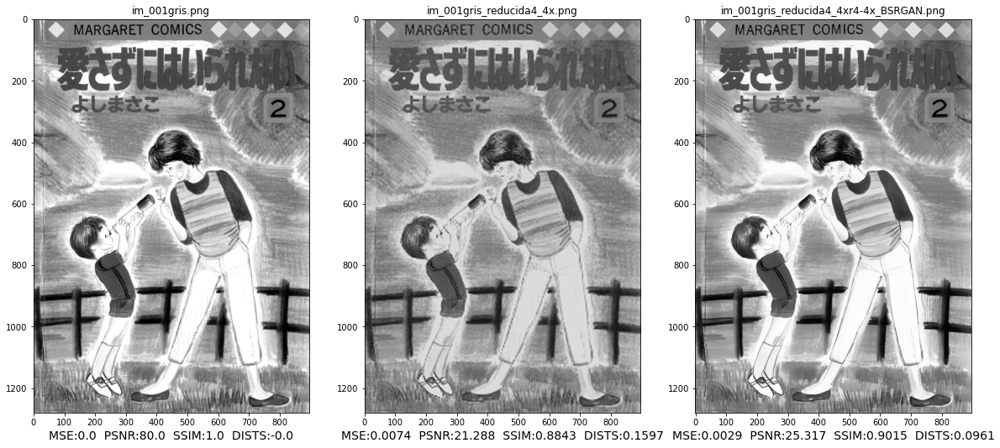

In [55]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,110,1,
                    'pruebas/Manga109mod128','gris',
                    'pruebas/Manga109mod128','gris_reducida4_4x',
                    'pruebasSRGAN/Manga109resultado128','gris_reducida4_4xr4-4x_BSRGAN')

Promedio MSE baja resolución: 0.0157
Promedio MSE optimizada: 0.0067
Diferencia promedio de MSE: 0.009


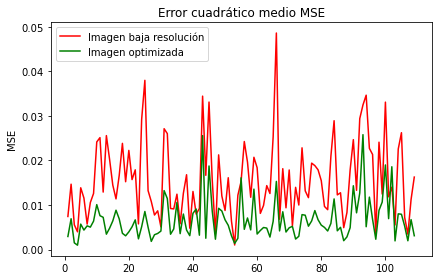

In [56]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 18.769
Promedio PSNR optimizada: 22.585
Diferencia promedio de PSNR: 3.817


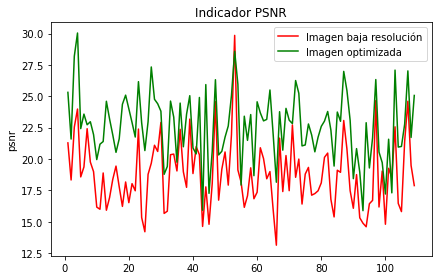

In [57]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8433
Promedio SSIM optimizada: 0.8983
Diferencia promedio de SSIM: 0.055


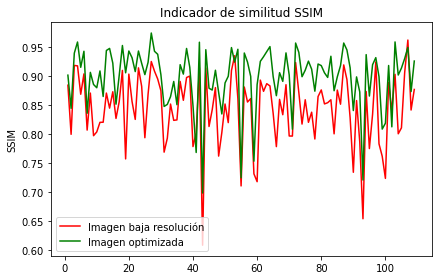

In [58]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.2093
Promedio DISTS optimizada: 0.0763
Diferencia promedio de DISTS: 0.133


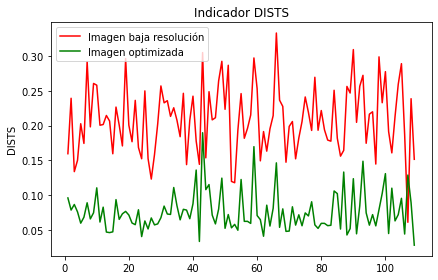

In [59]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba ESRGAN Set5

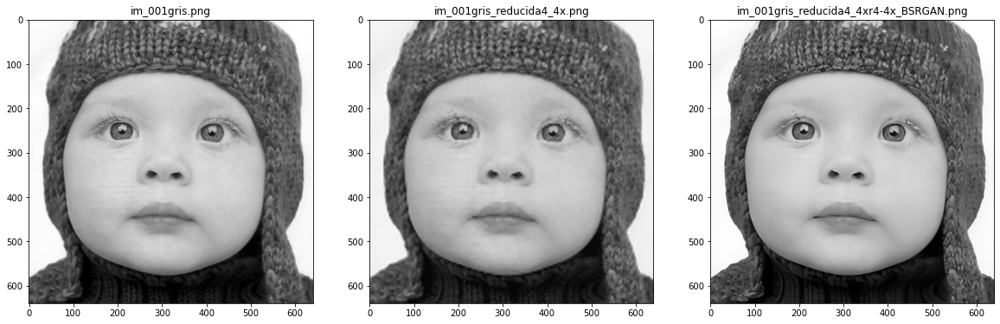

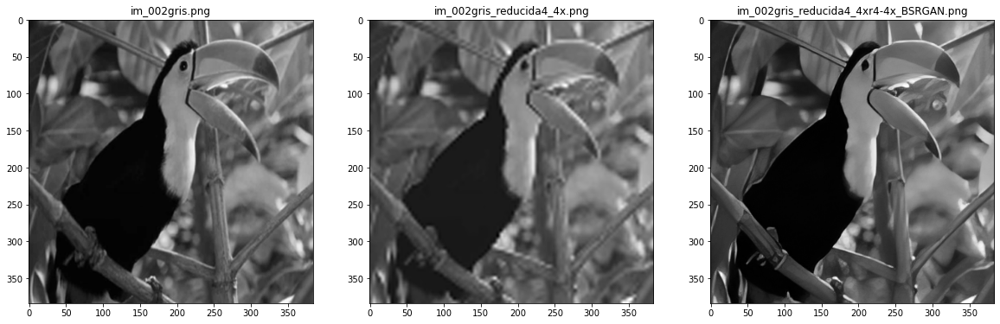

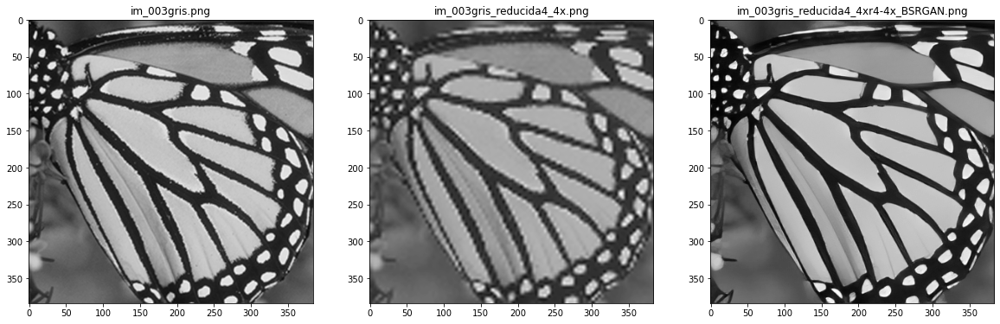

In [61]:
mostrar_imagen_3f(1,4,'pruebas/Set5mod128','gris',
                  'pruebas/Set5mod128','gris_reducida4_4x',
                  'pruebasSRGAN/Set5resultado128','gris_reducida4_4xr4-4x_BSRGAN')

1


D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


2
3
4
5


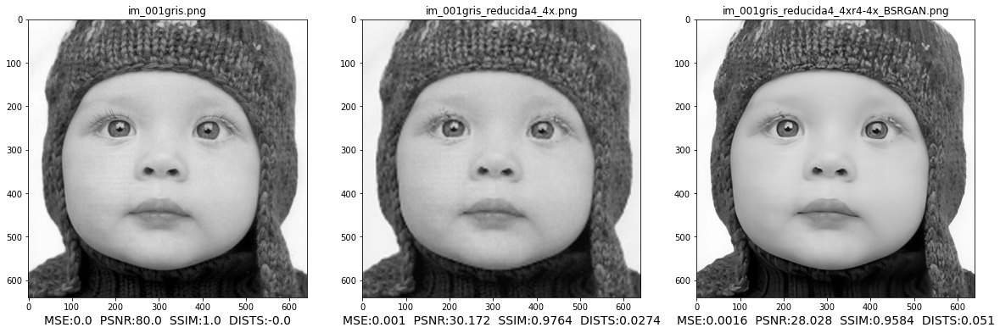

In [36]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,6,1,
                    'pruebas/Set5mod128','gris',
                    'pruebas/Set5mod128','gris_reducida4_4x',
                    'pruebasSRGAN/Set5resultado128','gris_reducida4_4xr4-4x_BSRGAN')

Promedio MSE baja resolución: 0.0041
Promedio MSE optimizada: 0.0029
Diferencia promedio de MSE: 0.0012


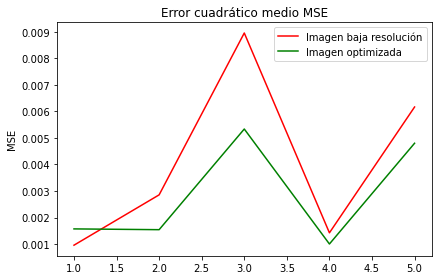

In [37]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 25.33
Promedio PSNR optimizada: 26.405
Diferencia promedio de PSNR: 1.075


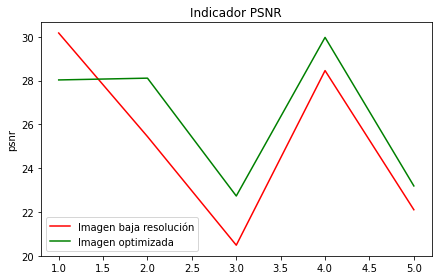

In [38]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.9356
Promedio SSIM optimizada: 0.9472
Diferencia promedio de SSIM: 0.0116


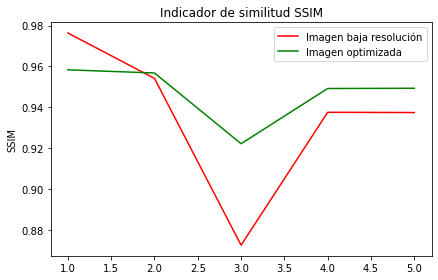

In [39]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.0748
Promedio DISTS optimizada: 0.0592
Diferencia promedio de DISTS: 0.0156


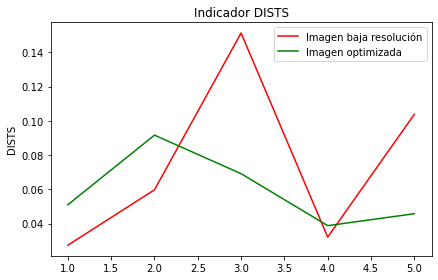

In [40]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba ESRGAN Set14

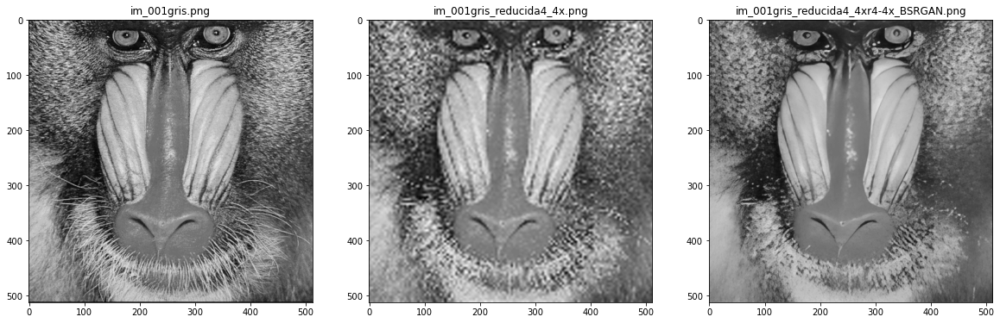

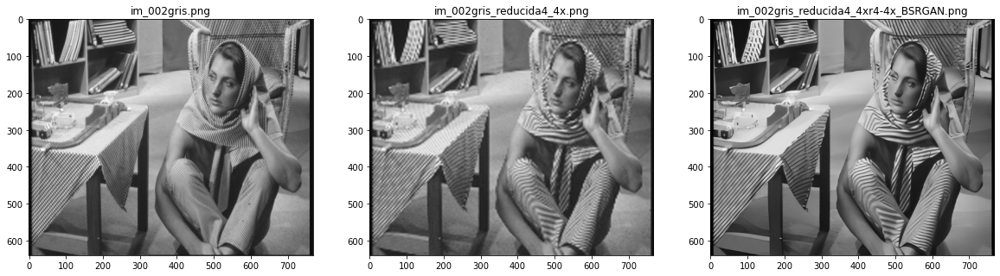

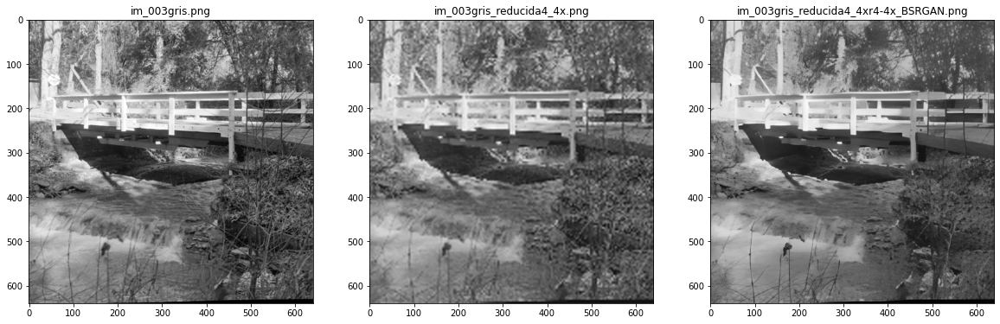

In [62]:
mostrar_imagen_3f(1,4,'pruebas/Set14mod128','gris',
                  'pruebas/Set14mod128','gris_reducida4_4x',
                  'pruebasSRGAN/Set14resultado128','gris_reducida4_4xr4-4x_BSRGAN')

1


D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


2
3
4
5
6
7
8
9
10
11
12
13
14


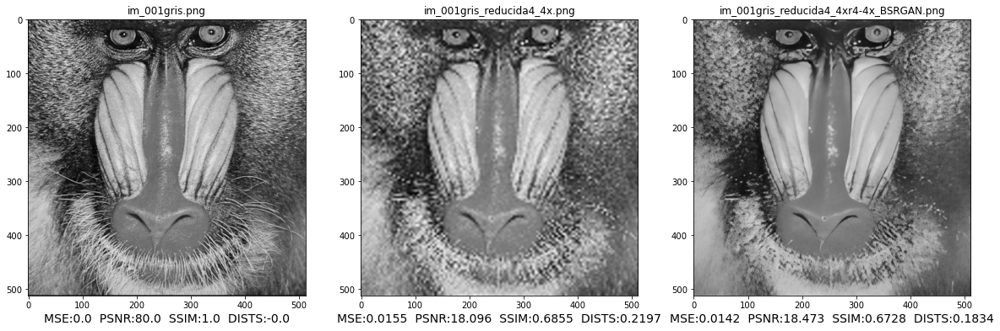

In [41]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,15,1,
                    'pruebas/Set14mod128','gris',
                    'pruebas/Set14mod128','gris_reducida4_4x',
                    'pruebasSRGAN/Set14resultado128','gris_reducida4_4xr4-4x_BSRGAN')  

Promedio MSE baja resolución: 0.0093
Promedio MSE optimizada: 0.0068
Diferencia promedio de MSE: 0.0025


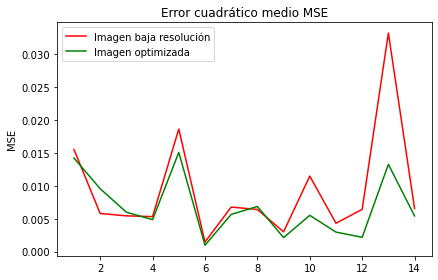

In [42]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 21.57
Promedio PSNR optimizada: 22.793
Diferencia promedio de PSNR: 1.222


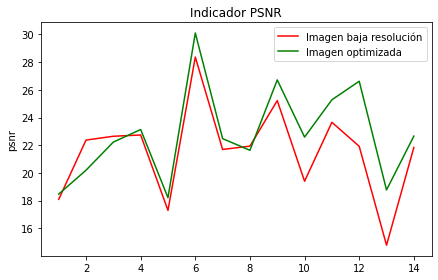

In [43]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.8482
Promedio SSIM optimizada: 0.8528
Diferencia promedio de SSIM: 0.0046


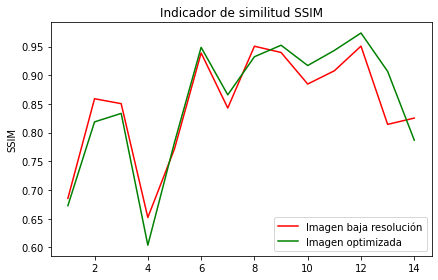

In [44]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.1784
Promedio DISTS optimizada: 0.0994
Diferencia promedio de DISTS: 0.079


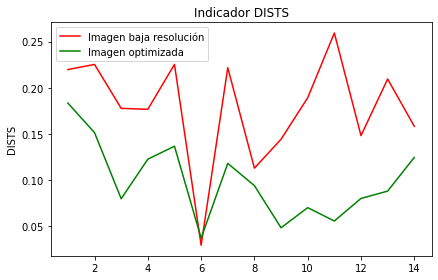

In [45]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')

# Prueba ESRGAN Urban100

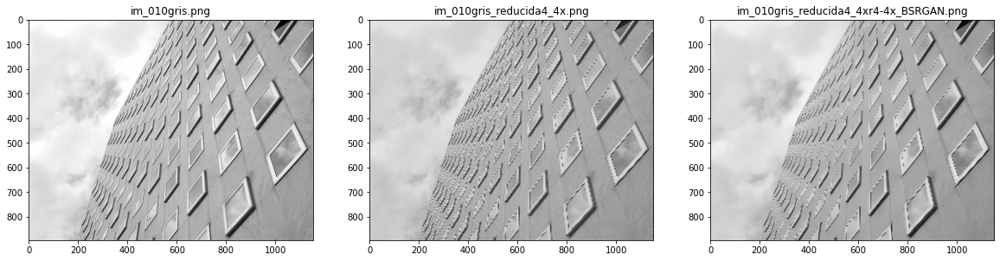

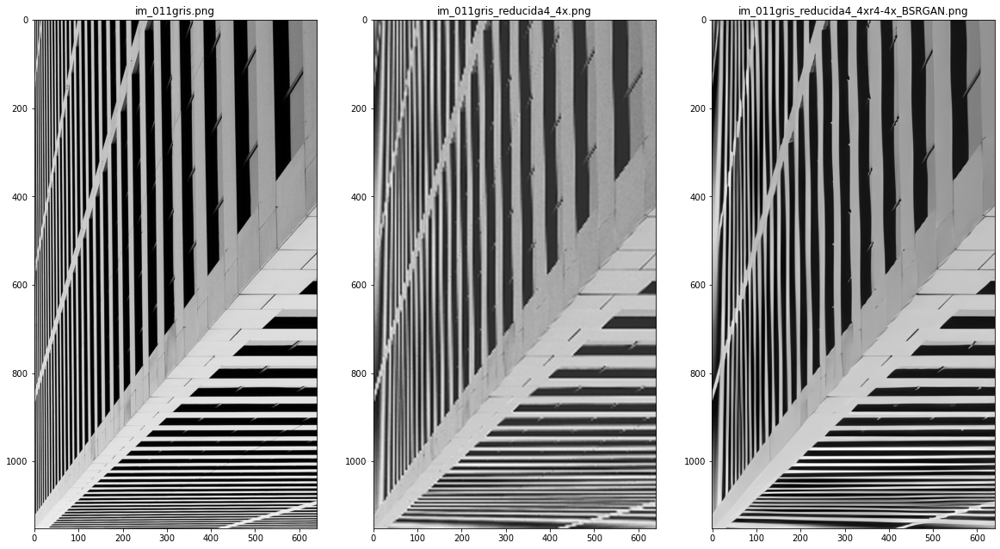

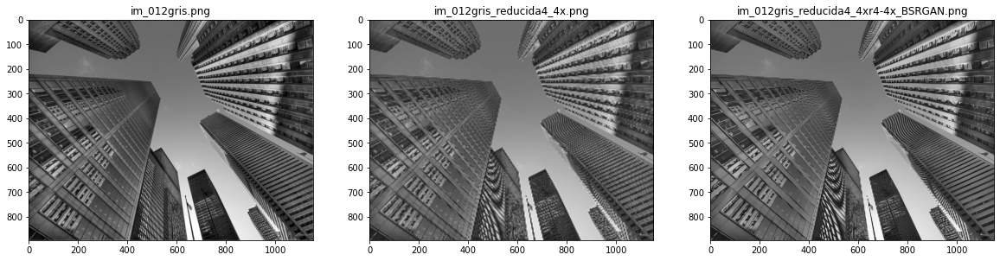

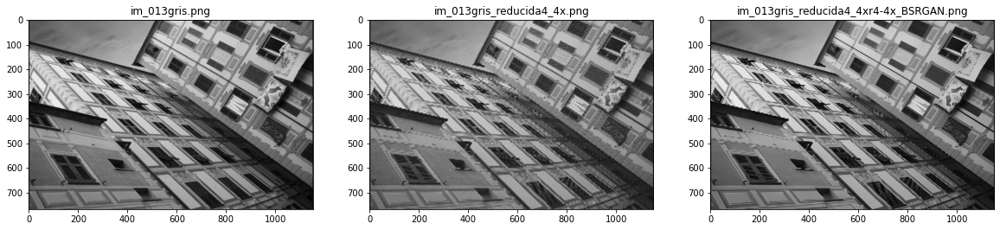

In [63]:
mostrar_imagen_3f(10,14,'pruebas/Urban100mod128','gris',
                  'pruebas/Urban100mod128','gris_reducida4_4x',
                  'pruebasSRGAN/Urban100resultado128','gris_reducida4_4xr4-4x_BSRGAN') 

1


D:\anaconda\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
D:\anaconda\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100


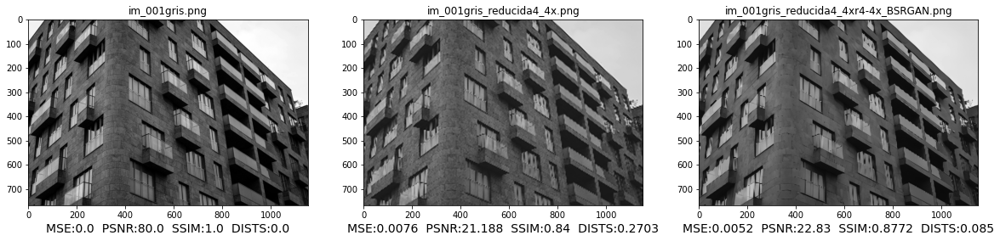

In [46]:
(y1mse,y2mse,y1ssim,y2ssim,y1psnr,y2psnr,y1dists,y2dists)=prueba_similitud(1,101,1,
                    'pruebas/Urban100mod128','gris',
                    'pruebas/Urban100mod128','gris_reducida4_4x',
                    'pruebasSRGAN/Urban100resultado128','gris_reducida4_4xr4-4x_BSRGAN')   

Promedio MSE baja resolución: 0.013
Promedio MSE optimizada: 0.0103
Diferencia promedio de MSE: 0.0027


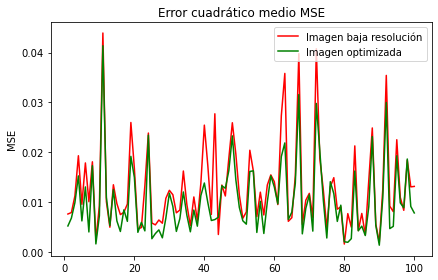

In [47]:
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1mse,color='r',label='Imagen baja resolución')
plt.plot(x1,y2mse,color='g',label='Imagen optimizada')
plt.title('Error cuadrático medio MSE')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('MSE')
plt.legend()

promedio_y1=np.sum(y1mse)/len(x1)
promedio_y2=np.sum(y2mse)/len(x1)
print('Promedio MSE baja resolución: '+str(round(promedio_y1,4)))
print('Promedio MSE optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de MSE: '+str(porcentaje_reduccion)+'')

Promedio PSNR baja resolución: 19.715
Promedio PSNR optimizada: 20.858
Diferencia promedio de PSNR: 1.143


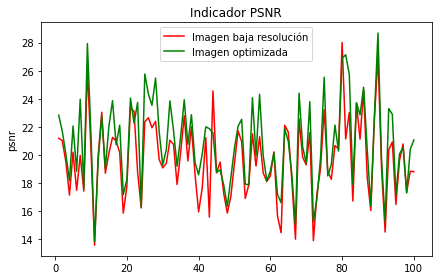

In [48]:
#print(np.array(y1psnr))
#print(np.array(y2psnr))
x1=np.linspace(1,len(y1psnr),len(y1psnr),dtype=int)
plt.plot(x1,y1psnr,color='r',label='Imagen baja resolución')
plt.plot(x1,y2psnr,color='g',label='Imagen optimizada')
plt.title('Indicador PSNR')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('psnr')
plt.legend()
promedio_y1=np.sum(y1psnr)/len(x1)
promedio_y2=np.sum(y2psnr)/len(x1)
print('Promedio PSNR baja resolución: '+str(round(promedio_y1,3)))
print('Promedio PSNR optimizada: '+str(round(promedio_y2,3)))
porcentaje_mejora=round((promedio_y2-promedio_y1),3)
print('Diferencia promedio de PSNR: '+str(porcentaje_mejora)+'')

Promedio SSIM baja resolución: 0.7881
Promedio SSIM optimizada: 0.8216
Diferencia promedio de SSIM: 0.0335


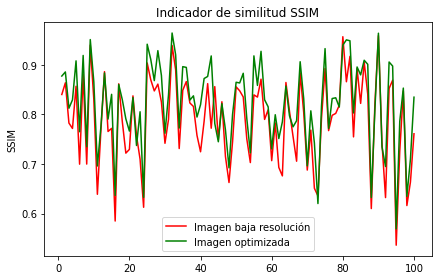

In [49]:
#print(np.array(y1ssim))
#print(np.array(y2ssim))
x1=np.linspace(1,len(y1ssim),len(y1ssim),dtype=int)
plt.plot(x1,y1ssim,color='r',label='Imagen baja resolución')
plt.plot(x1,y2ssim,color='g',label='Imagen optimizada')
plt.title('Indicador de similitud SSIM')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('SSIM')
plt.legend()
promedio_y1=np.sum(y1ssim)/len(x1)
promedio_y2=np.sum(y2ssim)/len(x1)
print('Promedio SSIM baja resolución: '+str(round(promedio_y1,4)))
print('Promedio SSIM optimizada: '+str(round(promedio_y2,4)))
porcentaje_mejora=round(promedio_y2-promedio_y1,4)
print('Diferencia promedio de SSIM: '+str(porcentaje_mejora)+'')

Promedio DISTS baja resolución: 0.2293
Promedio DISTS optimizada: 0.1011
Diferencia promedio de DISTS: 0.1282


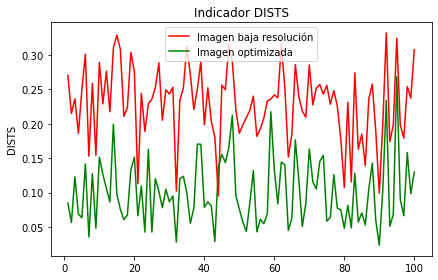

In [50]:
plt.plot(x1,y1dists,color='r',label='Imagen baja resolución')
plt.plot(x1,y2dists,color='g',label='Imagen optimizada')
plt.title('Indicador DISTS')
plt.tight_layout()
#plt.xlabel('imagen')
plt.ylabel('DISTS')
plt.legend()

promedio_y1=np.sum(y1dists)/len(x1)
promedio_y2=np.sum(y2dists)/len(x1)
print('Promedio DISTS baja resolución: '+str(round(promedio_y1,4)))
print('Promedio DISTS optimizada: '+str(round(promedio_y2,4)))
porcentaje_reduccion=round((promedio_y1-promedio_y2),4)
print('Diferencia promedio de DISTS: '+str(porcentaje_reduccion)+'')